Author: Elisa Perez

# Exploratory Data Analysis (EDA)

The primary goals of EDA are:

* Understand the Data: Gain insights into the data's underlying structure.
* Detect Outliers and Anomalies: Identify any unusual data points that may need special attention.
* Discover Patterns and Relationships: Explore potential relationships between variables.
* Prepare for Modeling: Ensure the data is ready for more advanced analysis or modeling.


### Understand the Problem


The problem to address is that currently there are no indicators or predictions regarding the budget, timelines, or statistical decisions related to the projects within the AGENCY's project portfolio.

### General Objective

The general objective is to develop a balanced scorecard for the Strategic Planning area, specifically for AGESIC’s portfolios, to provide indicators that support decision-making.

Specific Objectives
The specific objectives of the project are as follows:

* Develop a balanced scorecard with portfolio indicators (programs, projects, and operations) by August 2024.
* Integrate the WEKAN and SIGES systems. For projects where this integration exists, they will be included in the balanced scorecard. This integration will be completed by August 2024.
* Develop a machine learning model to predict the behavior of a new project relative to the existing ones by August 2024.



### About the Dataset
In this case, there are two databases: one relational SQL database (SIGES) and another non-relational MongoDB. Both were transformed into SQL using Pentaho PDI.

This dataset contains over 7 years of data, and the goal is to predict whether a project will finish within, over, or under budget based on certain variables. Additionally, an Exploratory Data Analysis (EDA) will be conducted, and we will focus on the variables that have a significant impact. Furthermore, other models will be generated based on the insights gained from the data.


The data provided by AGESIC is confidential.

Below is a list of everything that was installed to run the models, in addition to what is included in the requirements.txt file.

In [1]:
%pip install runtime.txt
%pip install streamlit
%pip install requirements.txt
%pip install seaborn
%pip install statsmodels
%pip install yfinance
%pip install optuna
%pip install --upgrade pip
%pip install Cython
%pip install fbprophet --quiet
%python -m pip install prophet
%%capture
%pip install fbprophet
%pip install prophet
%pip install pystan==2.19.1.1 prophet
%pip install --upgrade plotl
%pip install pmdarima
%pip install pandas-profiling
%pip install ipywidgets
%pip install wordcloud
%pip install figure
%python3 -m pip install scikit-learn
%pip install mysql-connector-python pandas
%pip install lazypredict

Note: you may need to restart the kernel to use updated packages.


ERROR: Could not find a version that satisfies the requirement runtime.txt (from versions: none)
ERROR: No matching distribution found for runtime.txt

[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


HINT: You are attempting to install a package literally named "requirements.txt" (which cannot exist). Consider using the '-r' flag to install the packages listed in requirements.txtNote: you may need to restart the kernel to use updated packages.


ERROR: Could not find a version that satisfies the requirement requirements.txt (from versions: none)
ERROR: No matching distribution found for requirements.txt

[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip



Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


  Obtaining dependency information for pip from https://files.pythonhosted.org/packages/d4/55/90db48d85f7689ec6f81c0db0622d704306c5284850383c090e6c7195a5c/pip-24.2-py3-none-any.whl.metadata
   ---------------------------------------- 1.8/1.8 MB 3.0 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 23.2.1
    Uninstalling pip-23.2.1:
      Successfully uninstalled pip-23.2.1
Note: you may need to restart the kernel to use updated packages.


  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.


Note: you may need to restart the kernel to use updated packages.


  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> [49 lines of output]
      running bdist_wheel
      running build
      running build_py
      creating build
      creating build\lib
      creating build\lib\fbprophet
      creating build\lib\fbprophet\stan_model
      Traceback (most recent call last):
        File "<string>", line 2, in <module>
        File "<pip-setuptools-caller>", line 34, in <module>
        File "C:\Users\perez\AppData\Local\Temp\pip-install-1099qd1l\fbprophet_bd954e55ec8f49bbb2a03ca189fd4d6e\setup.py", line 122, in <module>
          setup(
        File "c:\Users\perez\AppData\Local\Programs\Python\Python310\lib\site-packages\setuptools\__init__.py", line 87, in setup
          return distutils.core.setup(**attrs)
        File "c:\Users\perez\AppData\Local\Programs\Python\Python310\lib\site-packages\setuptools\_distutils\core.py", line 177, in setup
          return run_commands(dist)
 

In [1]:
# Apply the imports first
# Linear algebra
import numpy as np 

# Pandas profiling for Exploratory Data Analysis (EDA)
import pandas_profiling as pp 

# Data processing, CSV file I/O (e.g., pd.read_csv)
import pandas as pd 

# Data visualization
import matplotlib.pyplot as plt # Data visualization
import seaborn as sns # Data visualization
import plotly.express as px # Data visualization
import plotly.graph_objects as go
from scipy.stats import chi2_contingency, norm # Chi-square calculation

# Stocks-related missing information
import yfinance as yf

# Ignoring the warnings
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

%matplotlib inline

# Ranking the stocks
import matplotlib.pyplot as plt
import matplotlib.dates as dates
import optuna
from wordcloud import WordCloud, STOPWORDS # For word cloud generation

# Evaluate if they should be removed
import statsmodels.api as sm

# Time series
import datetime

# Uncomment to install Prophet if not already installed
#!pip install fbprophet --quiet
import plotly.offline as py
py.init_notebook_mode()

# Save model
import pickle

# Apply the "from" statements after the imports

# Evaluate if they should be removed
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn import linear_model
from matplotlib.pyplot import figure
from lazypredict.Supervised import LazyClassifier, LazyRegressor
# Ranking the stocks
from plotly.subplots import make_subplots

# Prophet Model Stuff
# Uncomment to install Prophet if not already installed
#!pip install fbprophet --quiet

from prophet import Prophet
from prophet.plot import plot_plotly
from prophet.plot import plot_yearly
from prophet.plot import add_changepoints_to_plot


# Get names of indexes for which column Stock has value No
from pickle import FALSE


# connect with my sql %pip install mysql-connector-python pandas
import mysql.connector


Connect with the Mysql

In [2]:
# Conectar a la base de datos MySQL
cnx = mysql.connector.connect(
    host='localhost',  # e.g., 'localhost' o la IP del servidor MySQL
    user='root',  # Usuario de MySQL
    password='',  # Contraseña de MySQL
    database='siges_dataset_proyecto'  # Nombre de la base de datos
)

# Leer la tabla en un DataFrame de pandas
query = "SELECT * FROM siges_dataset_proyecto"
df_siges = pd.read_sql(query, cnx)



c:\Users\perez\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\io\sql.py:761: UserWarning:

pandas only support SQLAlchemy connectable(engine/connection) ordatabase string URI or sqlite3 DBAPI2 connectionother DBAPI2 objects are not tested, please consider using SQLAlchemy



In [9]:
!pip list

Package                       Version              Editable project location
----------------------------- -------------------- -----------------------------------------------------------------
absl-py                       2.0.0
aext_assistant                0.4.0
aext_assistant_server         0.4.0
aext_core                     0.4.0
aext_core_server              0.4.0
aext_shared                   0.4.0
aiobotocore                   2.5.0
aiofiles                      22.1.0
aiohttp                       3.8.6
aioitertools                  0.7.1
aiosignal                     1.2.0
aiosqlite                     0.18.0
alabaster                     0.7.12
anaconda-anon-usage           0.4.3
anaconda-catalogs             0.2.0
anaconda-client               1.12.0
anaconda-cloud-auth           0.5.0
anaconda-navigator            2.6.0
anaconda-project              0.11.1
anyio                         3.5.0
appdirs                       1.4.4
archspec                      0.2.1
argon2-cf

## EDA 
FULL SIGES

In [187]:
df_siges.info(verbose = True, null_counts = True, buf=None, max_cols=None, memory_usage=None, show_counts=None)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183281 entries, 0 to 183280
Data columns (total 362 columns):
 #    Column                              Non-Null Count   Dtype         
---   ------                              --------------   -----         
 0    area_abreviacion                    154118 non-null  object        
 1    area_activo                         183281 non-null  int64         
 2    area_director                       151702 non-null  float64       
 3    area_habilitada                     183281 non-null  int64         
 4    area_nombre                         183281 non-null  object        
 5    area_org_fk                         183281 non-null  int64         
 6    area_padre                          171 non-null     float64       
 7    area_pk                             183281 non-null  int64         
 8    area_version                        183281 non-null  int64         
 9    cal_actualizacion                   369 non-null     datetime64[ns]


In [167]:
df_siges.head()

,area_abreviacion,area_activo,area_director,area_habilitada,area_nombre,area_org_fk,area_padre,area_pk,area_version,cal_actualizacion,...,risk_probabilidad,risk_superado,risk_usuario_superado_fk,risk_version,tipolec_lecc_apre_codigo,tipolec_lecc_apre_nombre,tipolec_lecc_apre_pk,usuario_cambio_activacion,version,version_1
0,TO,1,120.0,0,Transformacin Organizacional,1,NaN,1,0,NaT,...,NaN,NaN,NaN,NaN,None,None,NaN,None,NaN,None
1,Nor Fis,1,NaN,0,Normas y Fiscalizacin,1,NaN,4,0,NaT,...,NaN,NaN,NaN,NaN,None,None,NaN,None,NaN,None
2,TO,1,120.0,0,Transformacin Organizacional,1,NaN,1,0,NaT,...,NaN,NaN,NaN,NaN,None,None,NaN,None,NaN,None
3,TO,1,120.0,0,Transformacin Organizacional,1,NaN,1,0,NaT,...,NaN,NaN,NaN,NaN,None,None,NaN,None,NaN,None
4,TO,1,120.0,0,Transformacin Organizacional,1,NaN,1,0,NaT,...,NaN,NaN,NaN,NaN,None,None,NaN,None,NaN,None


In [9]:
# Profile for few registers
#profile = pp.ProfileReport(df_siges, title = "EDA")
#profile.to_file(output_file="reporte.html") 
# As a string
#json_data = profile.to_json()

# As a file
#profile.to_file("reporte.json")

We will remove the unnecessary columns, based on the report that identifies columns with high correlation. We also cross-checked this with the key project columns. Those with high correlation and high cardinality are the ones we considered keeping. In summary, 139 columns were extracted.

In [168]:
# Verificar las columnas presentes en el DataFrame
print(df_siges.columns)


Index(['area_abreviacion', 'area_activo', 'area_director', 'area_habilitada',
       'area_nombre', 'area_org_fk', 'area_padre', 'area_pk', 'area_version',
       'cal_actualizacion',
       ...
       'risk_probabilidad', 'risk_superado', 'risk_usuario_superado_fk',
       'risk_version', 'tipolec_lecc_apre_codigo', 'tipolec_lecc_apre_nombre',
       'tipolec_lecc_apre_pk', 'usuario_cambio_activacion', 'version',
       'version_1'],
      dtype='object', length=362)


In [188]:
# Lista de columnas a eliminar, sin incluir las que no existen
columnas_a_eliminar = ['proy_latlng_fk', 'proy_id_migrado', 'proy_leccion_aprendida', 'proy_risk_fk', 
                      'proy_org_fk', 'proy_est_pendiente_fk', 'proy_sol_aceptacion', 'proy_grp', 
                      'proy_ult_usuario', 'proy_ult_mod', 'proy_ult_origen', 'proy_version', 
                      'fecha_cambio_activacion', 'usuario_cambio_activacion', 'risk_superado', 
                      'version', 'risk_observaciones', 'ent_codigo', 'ent_status', 'ent_horas_estimadas', 
                      'ent_inicio_es_hito', 'ent_fin_es_hito', 'ent_collapsed', 'ent_assigs', 
                      'ent_predecesor_dias', 'version_1', 'ent_inicio_periodo', 'ent_fin_periodo', 
                      'ent_es_referencia', 'ent_referido', 'gas_pk', 'gas_tipo_fk', 'gas_usu_fk', 
                      'gas_mon_fk', 'gas_importe', 'gas_fecha', 'gas_obs', 'gas_aprobado', 'cal_pk', 
                      'cal_peso', 'cal_vca_fk', 'cal_actualizacion', 'cal_tipo', 'cal_ent_fk', 
                      'cal_prod_fk', 'cal_tca_fk', 'latlang_dep_fk', 'latlang_loc_fk', 'latlang_codigopostal', 
                      'latlang_barrio', 'latlang_loc', 'media_estado', 'media_principal', 'media_orden', 
                      'media_pub_fecha', 'media_usr_mod_fk', 'media_mod_fecha', 'media_usr_rech_fk', 
                      'media_rech_fecha', 'media_contenttype', 'part_activo', 'rh_comentario', 'rh_aprobado', 
                      'proy_publica_pk', 'proy_publica_fecha', 'proy_publica_usu_fk', 'lecapr_org_fk', 
                      'lecapr_activo', 'area_org_fk', 'area_padre', 'area_activo', 
                      'cro_proy_resources', 'cro_proy_permiso_escritura', 'cro_proy_version', 
                      'est_proy_label', 'est_proy_version', 'est_pendiente_pk', 'est_pendiente_codigo', 
                      'est_pendiente_nombre', 'est_pendiente_label', 'est_pendiente_orden_proceso', 
                      'est_pendiente_version', 'org_logo_nombre', 'org_direccion', 'org_logo', 
                      'org_activo', 'org_token', 'org_version', 'org_activo_siges_ind', 'pre_version', 
                      'pre_ocultar_pagos_confirmados', 'fue_org_fk', 
                      'prog_est_pendiente_fk', 'prog_sol_aceptacion', 'prog_cro_fk', 'prog_grp', 
                      'prog_version', 'prog_ult_usuario', 'prog_ult_mod', 'prog_ult_origen', 
                      'prog_factor_impacto', 'progpre_prog_fk', 'progpre_pre_fk', 
                      'fue_prog_pre_org_fk', 'fue_prog_pre_version', 'fue_prog_pre_habilitada', 
                      'cro_prog_pk', 'cro_prog_ent_seleccionado', 'cro_prog_ent_borrados', 
                      'cro_prog_resources', 'cro_prog_permiso_escritura', 'cro_prog_permiso_escritura_padre', 
                      'cro_prog_version', 'est_prog_lablel', 'est_prog_version', 'obj_est_prog_org_fk', 
                      'proyind_porc_peso_total', 'proyind_cal_ind', 'proyind_cal_pend', 'proyind_avance_par_verde', 
                      'proyind_avance_fin_verde', 'proyind_version', 'proy_otr_cont_fk', 'proy_otr_ins_eje_fk', 
                      'proy_otr_ent_fk', 'proy_otr_origen', 'proy_otr_plazo', 'proy_otr_observaciones', 
                      'proy_otr_cat_fk', 'proyint_proy_pk', 'proyint_int_pk', 'int_pk', 
                      'int_rolint_fk', 'int_observaciones', 'int_pers_fk', 'int_orga_fk', 'int_ent_fk', 
                      'int_tipo', 'int_usuario_fk']

# Filtrar las columnas que existen en el DataFrame
columnas_existentes = [col for col in columnas_a_eliminar if col in df_siges.columns]

# Eliminar las columnas existentes
data = df_siges.drop(columnas_existentes, axis=1)

# Mostrar la forma del DataFrame resultante
print(data.shape)


(183281, 223)


In [189]:
data.info(verbose = True, null_counts = True, buf=None, max_cols=None, memory_usage=None, show_counts=None)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183281 entries, 0 to 183280
Data columns (total 223 columns):
 #    Column                              Non-Null Count   Dtype         
---   ------                              --------------   -----         
 0    area_abreviacion                    154118 non-null  object        
 1    area_director                       151702 non-null  float64       
 2    area_habilitada                     183281 non-null  int64         
 3    area_nombre                         183281 non-null  object        
 4    area_pk                             183281 non-null  int64         
 5    area_version                        183281 non-null  int64         
 6    con_nombre                          662 non-null     object        
 7    con_org_fk                          662 non-null     float64       
 8    con_padre_fk                        549 non-null     float64       
 9    con_pk                              662 non-null     float64       


In the case of projects, there are several possible states through which the process of the project goes: initiation, planning, execution, and completion. There are also intermediate states for pending tasks. For our analysis we will be concerned with only those projects for which, from the estado table, estado_pk = 5, which indicates the projects which have been completed

In [190]:

indexNames = data[ data['proy_est_fk'] != 5 ].index
# Delete these row indexes from dataFrame

data.drop(indexNames,inplace=True)


In [191]:
data.info(verbose = True, null_counts = True, buf=None, max_cols=None, memory_usage=None, show_counts=None)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71383 entries, 0 to 183255
Data columns (total 223 columns):
 #    Column                              Non-Null Count  Dtype         
---   ------                              --------------  -----         
 0    area_abreviacion                    61697 non-null  object        
 1    area_director                       62311 non-null  float64       
 2    area_habilitada                     71383 non-null  int64         
 3    area_nombre                         71383 non-null  object        
 4    area_pk                             71383 non-null  int64         
 5    area_version                        71383 non-null  int64         
 6    con_nombre                          648 non-null    object        
 7    con_org_fk                          648 non-null    float64       
 8    con_padre_fk                        549 non-null    float64       
 9    con_pk                              648 non-null    float64       
 10   cro_pro

In [192]:
# Identificar columnas con 0 registros no nulos
columnas_a_eliminar = [col for col in data.columns if data[col].count() == 0]

print(f"Columnas a eliminar (0 non-null): {columnas_a_eliminar}")


Columnas a eliminar (0 non-null): ['fue_prog_pre_nombre', 'fue_prog_pre_pk', 'mon_cod_pais', 'mon_nombre', 'mon_pk', 'mon_prog_pre_cod_pais', 'mon_prog_pre_nombre', 'mon_prog_pre_pk', 'mon_prog_pre_signo', 'mon_prog_pre_version', 'mon_signo', 'pre_prog_base', 'pre_prog_fuente_organi_fk', 'pre_prog_moneda', 'pre_prog_ocultar_pagos_confirmados', 'pre_prog_pk', 'pre_prog_version', 'prog_pre_fk', 'progpre_version', 'proyind_periodo_fin_ent_fk', 'proyind_periodo_inicio_ent_fk']


In [193]:
# Eliminar columnas con 0 registros no nulos
data_limpio = data.drop(columns=columnas_a_eliminar)

print(f"El nuevo tamaño del DataFrame después de eliminar columnas vacías: {data_limpio.shape}")


El nuevo tamaño del DataFrame después de eliminar columnas vacías: (71383, 202)


In [194]:
# Paso 3: Confirmar la eliminación mostrando las columnas restantes
print(f"Columnas restantes: {data_limpio.columns}")

Columnas restantes: Index(['area_abreviacion', 'area_director', 'area_habilitada', 'area_nombre',
       'area_pk', 'area_version', 'con_nombre', 'con_org_fk', 'con_padre_fk',
       'con_pk',
       ...
       'risk_fecha_superado', 'risk_impacto', 'risk_nombre', 'risk_pk',
       'risk_probabilidad', 'risk_usuario_superado_fk', 'risk_version',
       'tipolec_lecc_apre_codigo', 'tipolec_lecc_apre_nombre',
       'tipolec_lecc_apre_pk'],
      dtype='object', length=202)


As the tables media, location (longitude and latitude) and media advertising are not data to be used either, since they are proper of the Mirador, we decided to exclude them. For example, the Mirador is an application derived from SIGES which publishes project progress for external audiences, but it doesn't include budget or detailed project data—only information for public dissemination. These projects have statuses such as 'in execution,' 'media,' and 'location,' among others. Given that they do not affect our target variable, we have made the choice to exclude them from our analysis

In [196]:
# Lista de columnas que deseas eliminar
columnas_a_eliminar_adicionales = [
    'rh_pk', 'rh_usu_fk', 'rh_ent_fk', 'rh_fecha', 'rh_horas',
    'media_publicable', 'media_comentario', 'media_pk', 'media_tipo_fk',
    'media_link', 'media_usr_pub_fk', 'latlng_pk', 'latlng_lat', 'latlng_lng','cro_proy_ent_borrados','mon_proy_cod_pais',
    'prog_usr_adjunto_fk',	'prog_usr_gerente_fk',	
'prog_usr_pmofed_fk',	
'prog_usr_sponsor_fk',	
'prog_usu_cod_adjunto'	,
'prog_usu_cod_gerente',	
'prog_usu_cod_pmofed',	
'prog_usu_cod_sponsor'	,
'prog_usu_id_adjunto',	
'prog_usu_id_pmofed',
'prog_usu_id_sponsor',	
'prog_usu_primer_apellido_adjunto',	
'prog_usu_primer_apellido_gerente',	
'prog_usu_primer_apellido_pmofed',	
'prog_usu_primer_apellido_sponsor',	
'prog_usu_primer_nombre_adjunto',	
'prog_usu_primer_nombre_pmofed',	
'prog_usu_primer_nombre_sponsor',
'proy_usu_adjunto_cod',	
'proy_usu_adjunto_primer_apellido',	
'proy_usu_gerente_cod',	
'proy_usu_gerente_primer_apellido',	
'proy_usu_pmofed_cod',	
'proy_usu_sponsor_cod',
]

# Eliminar las columnas del DataFrame
data_final = data_limpio.drop(columns=columnas_a_eliminar_adicionales)

# Mostrar el nuevo tamaño del DataFrame después de la eliminación
print(f"El nuevo tamaño del DataFrame después de eliminar las columnas adicionales: {data_final.shape}")

# Verificar que las columnas han sido eliminadas
print(f"Columnas restantes: {data_final.columns}")


El nuevo tamaño del DataFrame después de eliminar las columnas adicionales: (71383, 162)
Columnas restantes: Index(['area_abreviacion', 'area_director', 'area_habilitada', 'area_nombre',
       'area_pk', 'area_version', 'con_nombre', 'con_org_fk', 'con_padre_fk',
       'con_pk',
       ...
       'risk_fecha_superado', 'risk_impacto', 'risk_nombre', 'risk_pk',
       'risk_probabilidad', 'risk_usuario_superado_fk', 'risk_version',
       'tipolec_lecc_apre_codigo', 'tipolec_lecc_apre_nombre',
       'tipolec_lecc_apre_pk'],
      dtype='object', length=162)


In [197]:
data_final.info(verbose = True, null_counts = True, buf=None, max_cols=None, memory_usage=None, show_counts=None)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71383 entries, 0 to 183255
Data columns (total 162 columns):
 #    Column                            Non-Null Count  Dtype         
---   ------                            --------------  -----         
 0    area_abreviacion                  61697 non-null  object        
 1    area_director                     62311 non-null  float64       
 2    area_habilitada                   71383 non-null  int64         
 3    area_nombre                       71383 non-null  object        
 4    area_pk                           71383 non-null  int64         
 5    area_version                      71383 non-null  int64         
 6    con_nombre                        648 non-null    object        
 7    con_org_fk                        648 non-null    float64       
 8    con_padre_fk                      549 non-null    float64       
 9    con_pk                            648 non-null    float64       
 10   cro_proy_ent_seleccionado      

We will analyze each of the object data types to determine if it is necessary to change them to string.

In [198]:
data_final = data_final.astype({'proy_descripcion': 'string', 'proy_objetivo': 'string','proy_obj_publico': 'string',
'proy_situacion_actual': 'string',
'proy_nombre': 'string',
'proy_factor_impacto':'string',
'risk_nombre':'string',
'risk_efecto':'string',
'risk_estategia':'string',
'risk_disparador':'string',
'risk_contingencia':'string',
'risk_fecha_superado':'string',
'ent_nombre':'string',
'ent_descripcion':'string',
'lecapr_fecha':'string',
'lecapr_desc':'string',
'tipolec_lecc_apre_codigo':'string',
'tipolec_lecc_apre_nombre':'string',
'con_nombre':'string',
'area_nombre':'string',
'area_abreviacion':'string',
'obj_est_proy_nombre':'string',
'obj_est_proy_descripcion':'string',
'mon_proy_nombre':'string',
'mon_proy_signo':'string',
'fue_nombre':'string',
'prog_nombre':'string',
'prog_descripcion':'string',
'prog_objetivo':'string',
'prog_obj_publico':'string',
})
data_final.dtypes 

area_abreviacion             string
area_director               float64
area_habilitada               int64
area_nombre                  string
area_pk                       int64
                             ...   
risk_usuario_superado_fk    float64
risk_version                float64
tipolec_lecc_apre_codigo     string
tipolec_lecc_apre_nombre     string
tipolec_lecc_apre_pk        float64
Length: 162, dtype: object

The NaN values in the columns are being analyzed.

In [199]:
data_final.isna().sum()

area_abreviacion             9686
area_director                9072
area_habilitada                 0
area_nombre                     0
area_pk                         0
                            ...  
risk_usuario_superado_fk    57926
risk_version                55669
tipolec_lecc_apre_codigo    70516
tipolec_lecc_apre_nombre    70516
tipolec_lecc_apre_pk        70516
Length: 162, dtype: int64

In [200]:
data_final.describe(include='all')

,area_abreviacion,area_director,area_habilitada,area_nombre,area_pk,area_version,con_nombre,con_org_fk,con_padre_fk,con_pk,...,risk_fecha_superado,risk_impacto,risk_nombre,risk_pk,risk_probabilidad,risk_usuario_superado_fk,risk_version,tipolec_lecc_apre_codigo,tipolec_lecc_apre_nombre,tipolec_lecc_apre_pk
count,61697,62311.000000,71383.000000,71383,71383.000000,71383.0,648,648.000000,549.000000,648.000000,...,13457,15714.000000,15714,15714.000000,15714.000000,13457.000000,15714.0,867,867,867.000000
unique,174,NaN,NaN,220,NaN,NaN,32,NaN,NaN,NaN,...,888,NaN,2974,NaN,NaN,NaN,NaN,2,2,NaN
top,FDI,NaN,NaN,Fondo Desarrollo del Interior,NaN,NaN,Recursos Humanos,NaN,NaN,NaN,...,2017-07-24,NaN,Falta de materiales,NaN,NaN,NaN,NaN,AREPETIR,Repetir,NaN
freq,33665,NaN,NaN,33665,NaN,NaN,153,NaN,NaN,NaN,...,786,NaN,1494,NaN,NaN,NaN,NaN,763,763,NaN
first,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,396.817223,0.888531,NaN,140.380441,0.0,NaN,2.959877,1.193078,81.282407,...,NaN,5.623520,NaN,1923.694094,49.306351,422.341309,0.0,NaN,NaN,1.880046
std,NaN,162.194223,0.314714,NaN,73.880298,0.0,NaN,8.592883,0.395074,281.317675,...,NaN,2.279139,NaN,1297.898254,23.894163,233.606472,0.0,NaN,NaN,0.325095
min,NaN,83.000000,0.000000,NaN,1.000000,0.0,NaN,1.000000,1.000000,3.000000,...,NaN,2.000000,NaN,1.000000,20.000000,1.000000,0.0,NaN,NaN,1.000000
25%,NaN,327.000000,1.000000,NaN,123.000000,0.0,NaN,1.000000,1.000000,8.000000,...,NaN,4.000000,NaN,1075.000000,20.000000,240.000000,0.0,NaN,NaN,2.000000


In [201]:
profile = pp.ProfileReport(data_final, title = "EDA")
#profile.to_file(output_file="reportedataEDA.html") 

In [202]:
data_final.info(verbose = True, null_counts = True, buf=None, max_cols=None, memory_usage=None, show_counts=None)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71383 entries, 0 to 183255
Data columns (total 162 columns):
 #    Column                            Non-Null Count  Dtype         
---   ------                            --------------  -----         
 0    area_abreviacion                  61697 non-null  string        
 1    area_director                     62311 non-null  float64       
 2    area_habilitada                   71383 non-null  int64         
 3    area_nombre                       71383 non-null  string        
 4    area_pk                           71383 non-null  int64         
 5    area_version                      71383 non-null  int64         
 6    con_nombre                        648 non-null    string        
 7    con_org_fk                        648 non-null    float64       
 8    con_padre_fk                      549 non-null    float64       
 9    con_pk                            648 non-null    float64       
 10   cro_proy_ent_seleccionado      

In [203]:
# Filtrar columnas con menos de 71383 registros
columns_with_less_than_71383 = data_final.columns[data_final.apply(lambda x: x.count()) < 71383]

# Calcular la diferencia de registros
difference = 71383 - data_final[columns_with_less_than_71383].apply(lambda x: x.count())

# Crear un DataFrame con el resultado
result = pd.DataFrame({
    'Column': columns_with_less_than_71383,
    'Record Count': data_final[columns_with_less_than_71383].apply(lambda x: x.count()),
    'Difference from 71383': difference
})

# Ajustar el DataFrame para mejor visualización
result = result.reset_index(drop=True)
result.index += 1  # Inicia el índice en 1 en lugar de 0
result.columns = ['Column', 'Record Count', 'Difference from 71383']

# Aplicar estilo para mejorar la visualización
styled_result = result.style.format({
    'Record Count': '{:,.0f}',
    'Difference from 71383': '{:,.0f}'
}).background_gradient(subset=['Difference from 71383'], cmap='coolwarm')\
   .set_properties(**{
       'border': '1px solid black',
       'padding': '5px',
       'text-align': 'left'
   }).set_table_styles([
       {'selector': 'thead th', 'props': [('background-color', '#4CAF50'), ('color', 'white'), ('text-align', 'center')]},
       {'selector': 'tbody td', 'props': [('text-align', 'center')]}
   ]).set_caption("Filtered Columns and Differences")

# Mostrar la tabla estilizada
styled_result


,Column,Record Count,Difference from 71383
1,area_abreviacion,"61,697","9,686"
2,area_director,"62,311","9,072"
3,con_nombre,648,"70,735"
4,con_org_fk,648,"70,735"
5,con_padre_fk,549,"70,834"
6,con_pk,648,"70,735"
7,cro_proy_ent_seleccionado,"70,964",419
8,cro_proy_permiso_escritura_padre,"71,038",345
9,ent_coord_usu_fk,"11,061","60,322"
10,ent_cro_fk,"11,248","60,135"


# Recommendations:
Generate datasets to partition the analysis into different areas: Lessons Learned, Risks, Programs, and another dataset with Project Data.

# Risk Analysis

Based on the analysis below, the Risk columns were selected for this analysis. The selection was made based on the statistical data.

In [45]:
riesgos= data_final[['proy_pk','risk_pk','risk_nombre','risk_fecha_actu','risk_probabilidad','risk_impacto','risk_ent_fk','risk_fecha_limite','risk_efecto','risk_estategia','risk_disparador','risk_contingencia','risk_fecha_superado','risk_usuario_superado_fk','risk_exposicion']]


In [46]:
riesgos.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71383 entries, 0 to 183255
Data columns (total 15 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   proy_pk                   71383 non-null  int64         
 1   risk_pk                   15714 non-null  float64       
 2   risk_nombre               15714 non-null  string        
 3   risk_fecha_actu           15714 non-null  datetime64[ns]
 4   risk_probabilidad         15714 non-null  float64       
 5   risk_impacto              15714 non-null  float64       
 6   risk_ent_fk               11248 non-null  float64       
 7   risk_fecha_limite         15714 non-null  object        
 8   risk_efecto               11045 non-null  string        
 9   risk_estategia            10485 non-null  string        
 10  risk_disparador           3966 non-null   string        
 11  risk_contingencia         2401 non-null   string        
 12  risk_fecha_supera

In [48]:
# Filtrar columnas con menos de 71383 registros
columns_with_less_than_71383 = riesgos.columns[riesgos.apply(lambda x: x.count()) < 71383]

# Calcular la diferencia de registros
difference = 71383 - riesgos[columns_with_less_than_71383].apply(lambda x: x.count())

# Crear un DataFrame con el resultado
result = pd.DataFrame({
    'Column': columns_with_less_than_71383,
    'Record Count': riesgos[columns_with_less_than_71383].apply(lambda x: x.count()),
    'Difference from 71383': difference
})

# Ajustar el DataFrame para mejor visualización
result = result.reset_index(drop=True)
result.index += 1  # Inicia el índice en 1 en lugar de 0
result.columns = ['Column', 'Record Count', 'Difference from 71383']

# Aplicar estilo para mejorar la visualización
styled_result = result.style.format({
    'Record Count': '{:,.0f}',
    'Difference from 71383': '{:,.0f}'
}).background_gradient(subset=['Difference from 71383'], cmap='coolwarm')\
   .set_properties(**{
       'border': '1px solid black',
       'padding': '5px',
       'text-align': 'left'
   }).set_table_styles([
       {'selector': 'thead th', 'props': [('background-color', '#4CAF50'), ('color', 'white'), ('text-align', 'center')]},
       {'selector': 'tbody td', 'props': [('text-align', 'center')]}
   ]).set_caption("Filtered Columns and Differences")

# Mostrar la tabla estilizada
styled_result


,Column,Record Count,Difference from 71383
1,risk_pk,"15,714","55,669"
2,risk_nombre,"15,714","55,669"
3,risk_fecha_actu,"15,714","55,669"
4,risk_probabilidad,"15,714","55,669"
5,risk_impacto,"15,714","55,669"
6,risk_ent_fk,"11,248","60,135"
7,risk_fecha_limite,"15,714","55,669"
8,risk_efecto,"11,045","60,338"
9,risk_estategia,"10,485","60,898"
10,risk_disparador,"3,966","67,417"


In [50]:
# Filtrar columnas con menos de 15714 registros
columns_with_less_than_15714 = riesgos.columns[riesgos.apply(lambda x: x.count()) < 15714]

# Calcular la diferencia de registros
difference = 15714 - riesgos[columns_with_less_than_15714].apply(lambda x: x.count())

# Calcular el porcentaje sobre el total de riesgos
percentage = (riesgos[columns_with_less_than_15714].apply(lambda x: x.count()) / 15714) * 100

# Crear un DataFrame con el resultado
result = pd.DataFrame({
    'Column': columns_with_less_than_15714,
    'Record Count': riesgos[columns_with_less_than_15714].apply(lambda x: x.count()),
    'Difference from 15714': difference,
    'Percentage of Total Risks (%)': percentage
})

# Ajustar el DataFrame para mejor visualización
result = result.reset_index(drop=True)
result.index += 1  # Inicia el índice en 1 en lugar de 0
result.columns = ['Column', 'Record Count', 'Difference from 15714', 'Percentage of Total Risks (%)']

# Aplicar estilo para mejorar la visualización
styled_result = result.style.format({
    'Record Count': '{:,.0f}',
    'Difference from 15714': '{:,.0f}',
    'Percentage of Total Risks (%)': '{:.2f}%'
}).background_gradient(subset=['Difference from 15714'], cmap='coolwarm')\
   .set_properties(**{
       'border': '1px solid black',
       'padding': '5px',
       'text-align': 'left'
   }).set_table_styles([
       {'selector': 'thead th', 'props': [('background-color', '#4CAF50'), ('color', 'white'), ('text-align', 'center')]},
       {'selector': 'tbody td', 'props': [('text-align', 'center')]}
   ]).set_caption("Filtered Columns, Differences, and Percentage of Total Risks")

# Mostrar la tabla estilizada
styled_result



,Column,Record Count,Difference from 15714,Percentage of Total Risks (%)
1,risk_ent_fk,"11,248","4,466",71.58%
2,risk_efecto,"11,045","4,669",70.29%
3,risk_estategia,"10,485","5,229",66.72%
4,risk_disparador,"3,966","11,748",25.24%
5,risk_contingencia,"2,401","13,313",15.28%
6,risk_fecha_superado,"13,457","2,257",85.64%
7,risk_usuario_superado_fk,"13,457","2,257",85.64%


From the analysis, most of the risks focus on some critical few points. In particular, two categories, risk_ent_fk and risk_efecto, are very pertinent, representing 71.58% and 70.29% of the total risks, respectively. From this, deliverable-related risks and impact seem to be the most conspicuous concerns of the projects. The risk_estategia also turns out to be representative and hits the 66.72% mark, indicating that strategic risks are another critical point found within the field of vision. In its turn, risk_disparador and risk_contingencia account for 25.24% and 15.28% of the risks, respectively, indicating that triggers and contingency-driven risks are less frequent but not less important to take care of. Although a significant part of the risks is quite well covered, there is a need to enhance the identification and management of less prevalent but potentially critical risk categories.

In [102]:
riesgos.sample(5)

,proy_pk,risk_pk,risk_nombre,risk_fecha_actu,risk_probabilidad,risk_impacto,risk_ent_fk,risk_fecha_limite,risk_efecto,risk_estategia,risk_disparador,risk_contingencia,risk_fecha_superado,risk_usuario_superado_fk,risk_exposicion
32124,1756,NaN,<NA>,NaT,NaN,NaN,NaN,None,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN
5552,1200,NaN,<NA>,NaT,NaN,NaN,NaN,None,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN
118724,9338,5956.0,O01 Correcciones adicional en el RPS,2023-10-02,60.0,8.0,86921.0,2024-11-29 00:00:00,Conformacin de un marco reglamentario consiste...,EXPLORAR,Revisin del marco jurdico vigente,Recepcin de inquietudes y propuestas correctiv...,<NA>,NaN,5.0
87335,3342,2986.0,Tiempos del organismo,2018-12-14,40.0,8.0,36681.0,2018-06-30 00:00:00,<NA>,<NA>,<NA>,<NA>,2018-12-14,709.0,3.0
100069,5284,3892.0,Retraso en la puesta en produccin del nuevo ba...,2020-08-09,40.0,6.0,50877.0,2019-08-31 00:00:00,<NA>,<NA>,<NA>,<NA>,2020-08-09,160.0,2.0


In [57]:

# Supongamos que 'riesgos' es tu DataFrame original

# Convertir explícitamente las columnas numéricas, reemplazando NaN con 0
riesgos_filled_numeric = riesgos.select_dtypes(include=['number']).fillna(0).astype(float)

# Convertir explícitamente las columnas categóricas, reemplazando NaN con una cadena vacía
riesgos_filled_categorical = riesgos.select_dtypes(include=['object', 'string']).fillna('').astype(str)

# Combinar ambos DataFrames
riesgos_filled = pd.concat([riesgos_filled_numeric, riesgos_filled_categorical], axis=1)

# Descripción de columnas numéricas
numerical_summary = riesgos_filled_numeric.describe()

# Aplicar estilo a la tabla de estadísticas descriptivas
styled_numerical_summary = numerical_summary.style.background_gradient(cmap='Blues')\
                                              .set_properties(**{'border': '1px solid black',
                                                                 'text-align': 'center'})\
                                              .set_caption("Numerical Columns Summary")\
                                              .set_table_styles([{'selector': 'thead th',
                                                                  'props': [('background-color', '#4CAF50'),
                                                                            ('color', 'white')]}])

# Mostrar la tabla estilizada
try:
    display(styled_numerical_summary)
except ValueError as e:
    print(f"Error al mostrar la tabla numérica: {e}")

# Para columnas categóricas
categorical_columns = ['risk_nombre', 'risk_efecto', 'risk_estategia', 'risk_disparador', 'risk_contingencia']

# Crear un DataFrame para almacenar los conteos de valores categóricos
categorical_summary = pd.DataFrame()

for column in categorical_columns:
    categorical_summary[column] = riesgos_filled_categorical[column].value_counts()

# Limitar la visualización a las primeras 10 filas
categorical_summary_limited = categorical_summary.head(10)

# Aplicar estilo a la tabla de resumen categórico
styled_categorical_summary = categorical_summary_limited.style.background_gradient(cmap='coolwarm')\
                                                          .set_properties(**{'border': '1px solid black',
                                                                             'text-align': 'center'})\
                                                          .set_caption("Categorical Columns Summary")\
                                                          .set_table_styles([{'selector': 'thead th',
                                                                              'props': [('background-color', '#4CAF50'),
                                                                                        ('color', 'white')]}])

# Mostrar la tabla estilizada con un límite en el número de filas
try:
    display(styled_categorical_summary)
except ValueError as e:
    print(f"Error al mostrar la tabla categórica: {e}")



,proy_pk,risk_pk,risk_probabilidad,risk_impacto,risk_ent_fk,risk_usuario_superado_fk,risk_exposicion
count,71383.000000,71383.000000,71383.000000,71383.000000,71383.000000,71383.000000,71383.000000
mean,2245.088368,423.475183,10.854125,1.237942,4019.347198,79.619055,0.619433
std,1329.487848,1003.057625,23.303382,2.563709,10924.168499,193.842204,1.461485
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1337.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1786.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,2753.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,9661.000000,6093.000000,100.000000,10.000000,87356.000000,2164.000000,10.000000


,risk_nombre,risk_efecto,risk_estategia,risk_disparador,risk_contingencia
,55669,60338.000000,60898.000000,67417.000000,68982.000000
Falta de materiales,1494,nan,nan,nan,nan
Demoras por clima,1485,nan,nan,nan,nan
Falta instalaciones interiores,890,nan,nan,nan,nan
Demoras en el trmite,485,nan,nan,nan,nan
Vecinos no firman conforme,474,nan,nan,nan,nan
Baja de vecinos del Grupo,460,nan,nan,nan,nan
Demoras en el depsito de garanta,318,nan,nan,nan,nan
Errores en la documentacin,215,nan,nan,nan,nan
Documentacin incompleta,206,nan,nan,nan,nan


In [111]:
# Assuming `riesgos` is your DataFrame
# Generate the profile report
profile = pp.ProfileReport(riesgos, title="Riesgos Profile Report", explorative=True)

# Display the report within a Jupyter Notebook or save it as an HTML file
profile.to_notebook_iframe()  # For Jupyter Notebook

# If you want to save it to an HTML file
profile.to_file("riesgos_profile_report.html")


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Here the data points out various serious risk management gaps across projects. The high percentage of missing data in key risk-related fields such as risk identification, probability, impact, and mitigation reflects poor or inconsistent risk management practices during the projects or while documenting the same. Less comprehensive data can be a very significant limitation in managing and mitigating the risks effectively; it may also lead to some unexpected challenges during project execution. It is these data gaps that have to be given top priority so that risks can be identified, assessed, and managed during the life cycle of the project.

The strong correlations between the risk probabilities, impacts, and exposure suggest that those factors are associated with each other. This implies that if the likelihood or impact of a risk increases, the overall exposure does increase.

The data also suggests that the mitigation of risks seems to be closely related to the impact of the risk, which perhaps points to the fact that resources are being channeled into the mitigation of the most serious risks. The presence of invalid correlations and the varied strengths of some relationships prove that not all factors are equally important in the risk management process. To make this possible, it would be useful to explore the variables with the strong relations in more detail and see if the strategies of risk management are addressing these critical areas in the right fashion.

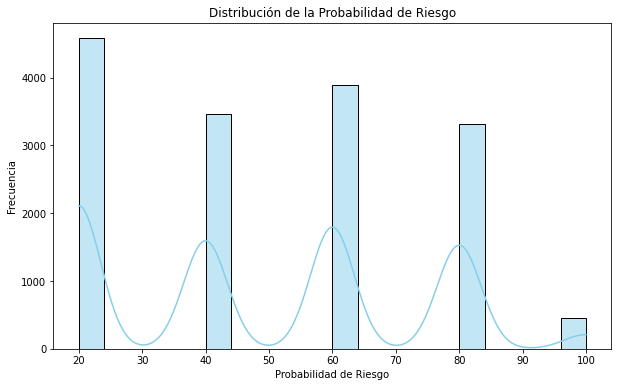

In [34]:
# Histograma de la probabilidad de riesgo
plt.figure(figsize=(10, 6))
sns.histplot(data=data_final, x='risk_probabilidad', kde=True, bins=20, color='skyblue')
plt.title('Distribución de la Probabilidad de Riesgo')
plt.xlabel('Probabilidad de Riesgo')
plt.ylabel('Frecuencia')
plt.show()


Probability Clusters: Probabilities for the risks are clustered around such values as 20%, 40%, 60%, 80%, and 100%, which would mean that they are assessed in such steps and not smoothly. This would point out to a standardized procedure of assessment.

Probabilities with the Highest Likelihood: 20%, 40%, 60%, and 80% are the most common probabilities. Occurrences of 100% are less likely. This means that the vast majority of risks are not perceived as certainties. Potential Assessment Gaps: Fewer risks are assigned probabilities at intermediate levels (30%, 50%, 70%, 90%)—a suggestion that there can be significant gaps in more nuanced assessments of risk.

Implications for Risk Management: Although clustering probabilities may make the assessment process straightforward, in reality, such clustering may hide the true risk landscape. More granular assessment could bring more accuracy to risk management strategies.

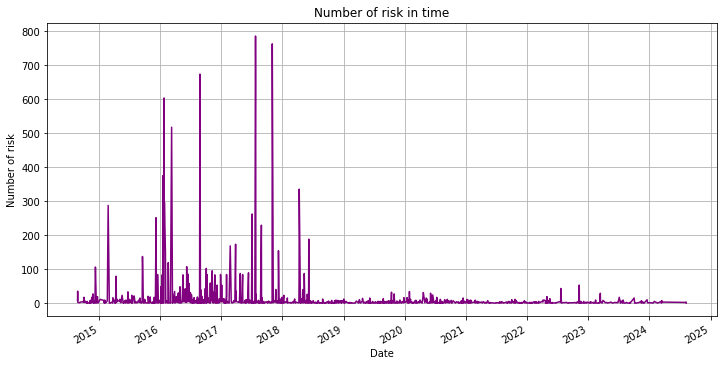

In [38]:
# Convertir 'risk_fecha_actu' a datetime si no lo está
data_final['risk_fecha_actu'] = pd.to_datetime(data_final['risk_fecha_actu'])

# Contar el número de riesgos por fecha
riesgos_por_fecha = data_final.groupby('risk_fecha_actu').size()

# Gráfico de líneas
plt.figure(figsize=(12, 6))
riesgos_por_fecha.plot(kind='line', color='purple')
plt.title('Number of risk in time')
plt.xlabel('Date')
plt.ylabel('Number of risk')
plt.grid(True)
plt.show()



This graph shows the number of identified risks over 2015 to 2025, and here are the key inferences from this:

Peak Risk Identification Period (2016-2018):

The greatest number of risks was recorded between 2016 and 2018, with a few sharp peaks where the number of risks tops out at 800. Evidently, this corresponds to a time when much risk identification activity was going on, possibly due to very large projects or an increase in focus on risk management.

Decline Post-2018:

After 2018, there is less risk identified. The frequency and volume of identified risks significantly decrease, with only little periodic minor spikes. This might be indicative of either a reduction in project activity, better risk mitigation strategies, or perhaps underreporting.

Minimal Risk Identification (2020-2025): So, risks identified in the period of 2020 and after that are very negligible. Only a few instances of recording sporadically come to the scene. The almost flat line in this period indicates that either risk identification processes are not very active or the number of projects under-process is relatively low.

Potential for Inactive Management of Risk:

This sustained low level of occurrence over the past few years and the sharp decline are raising serious concerns about whether risks are still being actively identified and recorded. This could be due to project completions or other reasons like shifts in focus or, probably, possible lapses in the risk management process.

Implications: A clear trend can be seen showing that while activity in the identification of risks was significant in the earlier years, there is a downfall in the recent years. This would require looking deeper for the causes of such a decline and ensure that the risk management processes remain robust and active, particularly for ongoing projects.

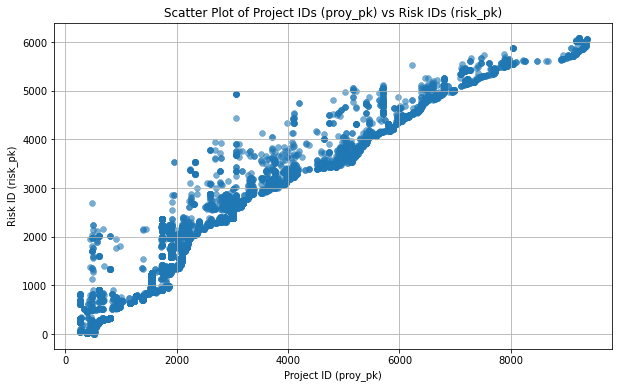

In [40]:
# Scatter plot of proy_pk vs risk_pk
plt.figure(figsize=(10, 6))
sns.scatterplot(x='proy_pk', y='risk_pk', data=data_final, alpha=0.6, edgecolor=None)
plt.title('Scatter Plot of Project IDs (proy_pk) vs Risk IDs (risk_pk)')
plt.xlabel('Project ID (proy_pk)')
plt.ylabel('Risk ID (risk_pk)')
plt.grid(True)
plt.show()


This scatter plot effectively highlights the relationship between project initiation and risk identification, showing a structured approach in assigning risks as projects advance.

In [44]:
# Step 1: Identify projects with at least one risk
projects_with_risks = data_final.groupby('proy_pk')['risk_pk'].count()
projects_with_at_least_one_risk = projects_with_risks[projects_with_risks > 0].count()

# Step 2: Calculate the total number of projects
total_projects = data_final['proy_pk'].nunique()

# Step 3: Calculate the percentage
percentage_with_risks = (projects_with_at_least_one_risk / total_projects) * 100

print(f"Percentage of projects with at least one associated risk: {percentage_with_risks:.2f}%")


Percentage of projects with at least one associated risk: 28.82%


<Figure size 720x576 with 0 Axes>

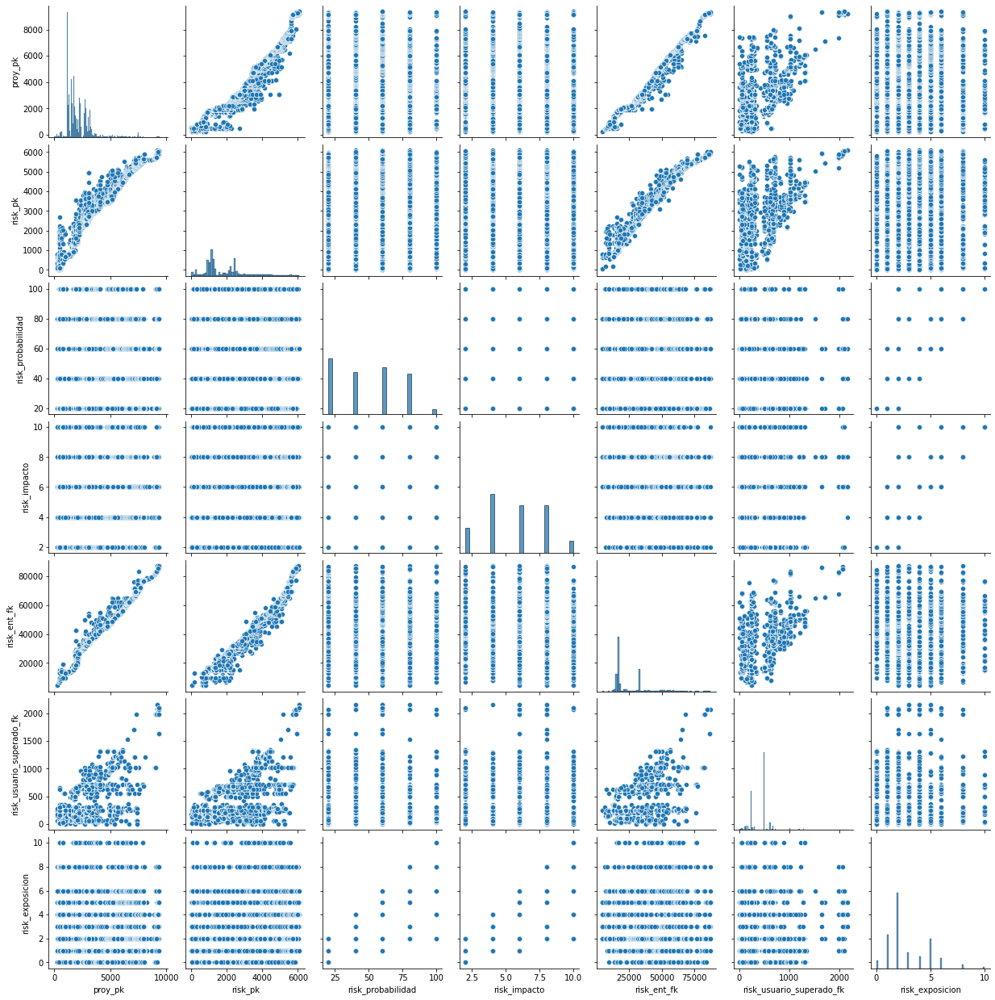

In [45]:
plt.figure(figsize=((10,8)))
sns.pairplot(data=riesgos)
plt.show()

In [58]:

riesgos.corr()["proy_pk"]

proy_pk                     1.000000
risk_pk                     0.956731
risk_probabilidad          -0.085089
risk_impacto               -0.018762
risk_ent_fk                 0.986014
risk_usuario_superado_fk    0.513870
risk_exposicion            -0.041425
Name: proy_pk, dtype: float64

In [47]:
riesgos_corr = riesgos.corr().transpose()
riesgos_corr

,proy_pk,risk_pk,risk_probabilidad,risk_impacto,risk_ent_fk,risk_usuario_superado_fk,risk_exposicion
proy_pk,1.000000,0.956540,-0.085857,-0.019655,0.986014,0.513870,-0.042570
risk_pk,0.956540,1.000000,-0.084199,-0.052652,0.947865,0.460579,-0.055150
risk_probabilidad,-0.085857,-0.084199,1.000000,0.010183,-0.113469,0.056845,0.741197
risk_impacto,-0.019655,-0.052652,0.010183,1.000000,0.022877,-0.184510,0.596880
risk_ent_fk,0.986014,0.947865,-0.113469,0.022877,1.000000,0.395245,-0.018096
risk_usuario_superado_fk,0.513870,0.460579,0.056845,-0.184510,0.395245,1.000000,-0.054018
risk_exposicion,-0.042570,-0.055150,0.741197,0.596880,-0.018096,-0.054018,1.000000


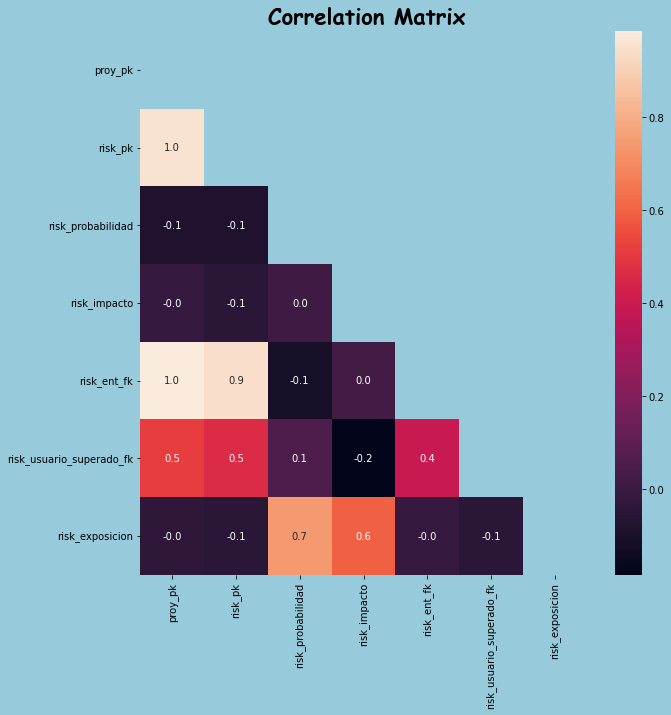

In [48]:
# Using a different way of correlation matrix

background_color = "#97CADB"

fig = plt.figure(figsize=(10,10))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax0 = fig.add_subplot(gs[0,0])
fig.patch.set_facecolor(background_color) 
ax0.set_facecolor(background_color) 

# train_data_corr = train_data[['Age', 'Fare', 'SibSp', 'Parch', 'Pclass','Survived']].corr().transpose()
mask = np.triu(np.ones_like(riesgos_corr))
ax0.text(2,-0.1,"Correlation Matrix",fontsize=22, fontweight='bold', fontfamily='cursive', color="#000000")
sns.heatmap(riesgos_corr ,mask=mask,fmt=".1f",annot=True)
plt.show()

##### General Conclusions

* Strong relationships: A high correlation between risk_pk and risk_ent_fk indicates a patterned relationship in your data, which might imply that some particular entities are constantly associated with some particular risks.
* Moderate correlations: Risk_probabilidad, risk_impacto, and risk_exposicion all have moderate levels of correlation. This implies that, by and large, risks with a greater probability or impact will also turn out to have more exposure, as one would expect in risk management.
* Low or No Correlations: The lack of strong correlations for some variables, namely proy_pk with the other variables, shows that these are identifiers that are independent of each other.

In [49]:
riesgos2=riesgos[riesgos['risk_nombre'].str.contains('Desarrollo|pago|Gateway|equipo|soluciones|ws|integracion|proyectos|pasarela|pagos|produccin|dificultades|autoridades|asignacin|disponibilidad|sponsor|retrasos|demoras|autoridades|organismo|proveedor|institucin|institucion|involucramiento|fallas|dificultades|publicacin|personal|cambios|gestion|clave|recursos|contrataciones|compras|adquisiciones|personal|infraestructura', case=False)]

In [50]:
riesgos2.isna().sum()

proy_pk                        0
risk_pk                        0
risk_nombre                    0
risk_fecha_actu                0
risk_probabilidad              0
risk_impacto                   0
risk_ent_fk                 1623
risk_fecha_limite              0
risk_efecto                 1583
risk_estategia              1902
risk_disparador             4687
risk_contingencia           4809
risk_fecha_superado          560
risk_usuario_superado_fk     560
risk_exposicion                0
dtype: int64

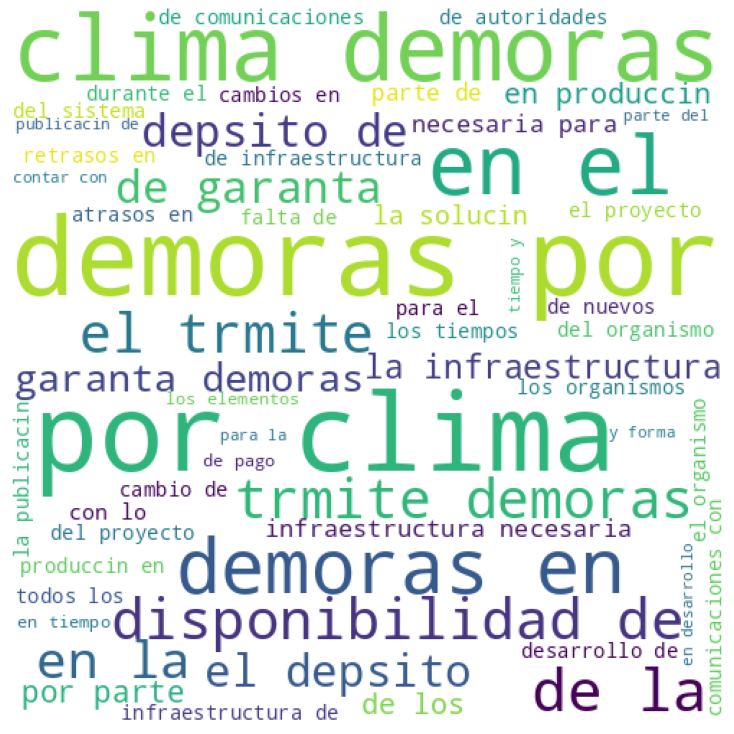

In [51]:
#Nube de palabras para “Group of weather parameters“.
# Python program to generate WordCloud
comment_words = ''
stopwords = set(STOPWORDS)
# iterate through the csv file
for val in riesgos2.risk_nombre:
# typecaste each val to string
    val = str(val)
# split the value
    tokens = val.split()
# Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()   
    comment_words += " ".join(tokens)+" "
wordcloud = WordCloud(width = 500, height = 500,
                    background_color ='white',
                    stopwords = stopwords,
                    min_font_size = 10).generate(comment_words)
# plot the WordCloud image
plt.figure(figsize = (10, 10), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.show()

Conclusion:
Focus Areas for Risk Management: The word cloud reveals that weather and delays are critical risk factors in your projects. Focusing on mitigating these risks could lead to smoother project execution.
Potential for Further Analysis: If specific terms are emerging repeatedly, it might be worth analyzing the contexts in which they appear to develop targeted strategies for risk reduction.

The most important:

* Falta de materiales                                  1494
* Demoras por clima                                    1485
* Falta instalaciones interiores                        890
* Demoras en el trmite                                  485


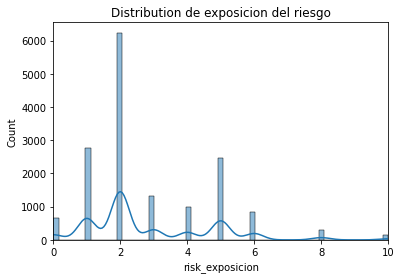

In [52]:
sns.histplot(data=riesgos, x="risk_exposicion", kde=True)
plt.title('Distribution de exposicion del riesgo')
plt.xlim(0, 10)
plt.show()

Conclusion: 

* Risk Profile:

This would indicate that, in general, your projects are exposed to low- to moderate-risk levels. The concentration around the lower exposure levels, more or less around 2, clearly shows that most of the risks are not really serious, as far as possible impact is concerned.

* Areas of Focus on Risk Management:

Since lower exposure risks happen more frequently, the management and mitigation of such risks may be worth focusing on in order to prevent them from escalating. It is, however, true that the less frequent but higher-exposure risks need to be watched very carefully because if realized, their effects may well be substantial.

* Potential Actions:

Consider strategies that will further reduce even these low-exposure risks, as a reduction in frequency or impact of such risks may enhance the overall project stability. There must be strong backup plans in place for the more rare and high-exposure risks in order to minimize potential negative impact.

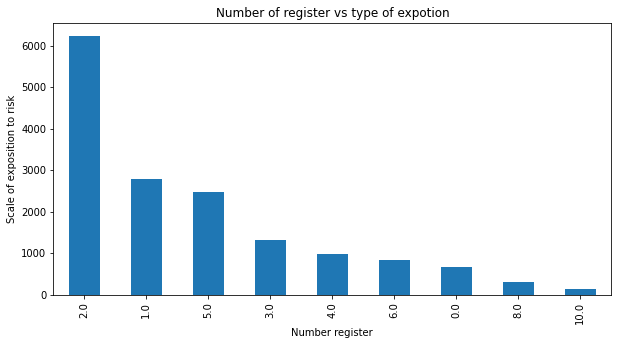

In [56]:
riesgos.risk_exposicion.value_counts().nlargest(40).plot(kind='bar', figsize=(10,5))
plt.title('Number of register vs type of expotion')
plt.ylabel('Scale of exposition to risk')
plt.xlabel('Number register');


Conclusion: 

* Concentration of Risk Exposure: The majority of risks in your data set fall mostly within the confines of lower exposure at most levels. This is particularly clear at levels 2.0, 1.0, and 5.0, suggesting most risks in your data set are considered to be relatively low to moderately exposed risk levels.

* Focus Areas: The large number of risks at the level 2.0 exposure might suggest some standard threshold or categorization that is often employed in the process of the assessment. This might be some sort of average "low risk" or "manageable risk" level that is typically ascribed. The presence of extreme records (0.0, 10.0) suggests that there are a few perceived as minimal or extremely high, but these are much less common.

* Risk Management Implications: Prioritization: There is great usefulness in directing all the effort in risk management to areas where there are high concentrations at certain exposure levels, ensuring that mitigation strategies are of levels appropriate for the most probable levels of risk. Careful to Extremes: Less likely risks, but those at higher exposure levels (e.g., 10), should also be taken care of because they might have a large effect, even if rare.

* Steps Possible: Review why so many organizations use the 2.0 exposure level. It may be worth looking at this as an indicator of the actual risk landscape or whether it is due to some particular way of assessing. Question if the risks at the lower frequencies yet higher exposure levels (on the order of 10.0) are being duly accounted for, as they tend to have more dire consequences in case of poor management.

In [58]:
len(riesgos['proy_pk'].unique())

4191

In [59]:
#Lista cuantos proyectos hay con riesgos altos
riesgos_altos=riesgos[riesgos['risk_exposicion']>= 6.0]
len(riesgos_altos['proy_pk'].unique())




299

In this case, there are 299 projects with high risks, which represent 7% of the total project portfolio.

Therefore, 7% of the projects have high risks.

In [60]:
len(riesgos['risk_ent_fk'].unique())

1731

In [61]:
#Lista cuantos proyectos hay con riesgos altos
entregables_riesgos_altos=riesgos[riesgos['risk_exposicion']>= 6.0]
len(riesgos_altos['risk_ent_fk'].unique())


311

18% of the deliverables that contain risks are high-risk, where the Pareto principle (80/20 rule) applies.

In [113]:
# Assuming `riesgos` is your DataFrame
# Example: If you're predicting `risk_exposicion`
X = riesgos.drop('risk_exposicion', axis=1)  # Features
y = riesgos['risk_exposicion']  # Target variable

# Splitting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [114]:
# Initialize LazyClassifier
clf = LazyClassifier(verbose=0, ignore_warnings=True, custom_metric=None)

# Fit the models and get predictions
models, predictions = clf.fit(X_train, X_test, y_train, y_test)

# Display the model performance
print(models)


100%|██████████| 29/29 [00:02<00:00, 10.80it/s]

Empty DataFrame
Columns: [Accuracy, Balanced Accuracy, ROC AUC, F1 Score, Time Taken]
Index: []


In [115]:
# Initialize LazyRegressor
reg = LazyRegressor(verbose=0, ignore_warnings=True, custom_metric=None)

# Fit the models and get predictions
models, predictions = reg.fit(X_train, X_test, y_train, y_test)

# Display the model performance
print(models)


100%|██████████| 42/42 [00:05<00:00,  7.59it/s]

Empty DataFrame
Columns: [Adjusted R-Squared, R-Squared, RMSE, Time Taken]
Index: []


The Empty DataFrame message suggests that no models were successfully evaluated or no metrics were recorded for any of the models.

#### Sum up

1. Risk Profile and Key Findings:

Concentration of Risks: The analysis focused on 15 variables representing risks. Out of these, 9 risks were detected, with 4 being the most prominent. The risk distribution follows a long-tail pattern, with 63% classified as low risks, 30% as medium risks, and 7% as high risks. Over 70% of risks are linked to deliverables (71.58%) and strategy (66.72%), while contingency plans are applied in only 15.28% of cases.

Data Gaps and Inconsistencies: There are significant data gaps in areas such as risk identification, probability, impact, and mitigation. These gaps raise concerns about inconsistent application of risk management practices, which could lead to blind spots.

Risk Probability Distribution: Risk probabilities cluster around values like 20%, 40%, 60%, and 80%, reflecting a standardized yet possibly oversimplified risk assessment approach.

Temporal Trends: Risk identification peaked between 2016 and 2018, followed by a significant decline, potentially signaling a decrease in project activity or underreporting of risks.

Risk Exposure: Most risks are clustered at lower exposure levels, especially around level 2.0. This suggests a focus on low to moderate risks, while less frequent but high-risk exposures may be overlooked.

2. High-Risk Projects:

7% of the project portfolio is classified as high-risk, and 18% of deliverables associated with risks are also high-risk. These projects require special attention and strong risk mitigation strategies.

Recommendations:

1. Enhance Risk Identification and Documentation:
Improve the risk recording process to capture more detailed and comprehensive information.
Standardize risk categorization for consistency and clearer analysis.
Focus on identifying more risk opportunities across all categories.

2. Address Data Gaps:
Prioritize completing risk-related fields like probability, impact, and mitigation across all projects.
Ensure consistency in risk assessment to avoid gaps that could lead to unexpected project challenges.

3. Refine the Risk Assessment Process:
Consider a more granular evaluation of risk probabilities to capture the full spectrum of risk levels.
Investigate why the 2.0 exposure level is predominant and whether it accurately reflects the true risk landscape.

4. Investigate the Temporal Decline in Risk Identification:
Analyze the post-2018 decline in risk identification to understand if it reflects reduced project activity, improved risk management, or potential underreporting.

5. Focus on High-Risk Projects and Deliverables:
Ensure close monitoring and proactive mitigation strategies for high-risk projects and deliverables.
Pay attention to rare but high-exposure risks, as they could have significant impacts if not managed properly.

6. Develop Targeted Mitigation Strategies:
Focus on managing risks related to deliverables and strategic decisions, as they represent the majority of the identified risks.
Strengthen risk management around less frequently identified risks like triggers and contingency planning.

7. Strengthen Risk Management Training:
Provide training to project teams to ensure more consistent and accurate risk assessments, particularly in underrepresented areas.

8. Regular Risk Review and Monitoring:
Implement regular risk reviews across all projects to identify emerging risks.
Continuously monitor and adjust risk management processes to address any gaps or inefficiencies.
By addressing these key areas, the organization can improve its risk management practices and ensure that potential risks are adequately identified, assessed, and mitigated throughout the project lifecycle.

# Analysis of Lessons Learned

Below is an analysis of the lessons learned from the projects:

A continuacion se muestra el analisis de las lecciones aprendidas de los proyectos:

In [110]:
lecciones_app=data_final[['proy_pk','con_padre_fk','con_org_fk','con_nombre','con_pk','lecaprcon_con_fk','lecaprcon_lecapr_fk','lecapr_pk','lecapr_tipo_fk','lecapr_usr_fk','lecapr_fecha','lecapr_desc','tipolec_lecc_apre_pk','tipolec_lecc_apre_codigo','tipolec_lecc_apre_nombre']]


In [111]:
lecciones_app.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71383 entries, 0 to 183255
Data columns (total 15 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   proy_pk                   71383 non-null  int64  
 1   con_padre_fk              549 non-null    float64
 2   con_org_fk                648 non-null    float64
 3   con_nombre                648 non-null    string 
 4   con_pk                    648 non-null    float64
 5   lecaprcon_con_fk          648 non-null    float64
 6   lecaprcon_lecapr_fk       648 non-null    float64
 7   lecapr_pk                 867 non-null    float64
 8   lecapr_tipo_fk            867 non-null    float64
 9   lecapr_usr_fk             867 non-null    float64
 10  lecapr_fecha              867 non-null    string 
 11  lecapr_desc               867 non-null    string 
 12  tipolec_lecc_apre_pk      867 non-null    float64
 13  tipolec_lecc_apre_codigo  867 non-null    string 
 14  tipol

In [63]:
import pandas as pd

# Filtrar columnas con menos de 71383 registros
columns_with_less_than_71383 = lecciones_app.columns[lecciones_app.apply(lambda x: x.count()) < 71383]

# Calcular la diferencia de registros
difference = 71383 - lecciones_app[columns_with_less_than_71383].apply(lambda x: x.count())

# Crear un DataFrame con el resultado
result = pd.DataFrame({
    'Column': columns_with_less_than_71383,
    'Record Count': lecciones_app[columns_with_less_than_71383].apply(lambda x: x.count()),
    'Difference from 71383': difference
})

# Ajustar el DataFrame para mejor visualización
result = result.reset_index(drop=True)
result.index += 1  # Inicia el índice en 1 en lugar de 0
result.columns = ['Column', 'Record Count', 'Difference from 71383']

# Aplicar estilo para mejorar la visualización
styled_result = result.style.format({
    'Record Count': '{:,.0f}',
    'Difference from 71383': '{:,.0f}'
}).background_gradient(subset=['Difference from 71383'], cmap='coolwarm')\
   .set_properties(**{
       'border': '1px solid black',
       'padding': '5px',
       'text-align': 'center'
   }).set_table_styles([
       {'selector': 'thead th', 'props': [('background-color', '#4CAF50'), ('color', 'white'), ('text-align', 'center')]},
       {'selector': 'tbody td', 'props': [('text-align', 'center')]}
   ]).set_caption("Filtered Columns and Differences")

# Mostrar la tabla estilizada
styled_result



,Column,Record Count,Difference from 71383
1,con_padre_fk,549,"70,834"
2,con_org_fk,648,"70,735"
3,con_nombre,648,"70,735"
4,con_pk,648,"70,735"
5,lecaprcon_con_fk,648,"70,735"
6,lecaprcon_lecapr_fk,648,"70,735"
7,lecapr_pk,867,"70,516"
8,lecapr_tipo_fk,867,"70,516"
9,lecapr_usr_fk,867,"70,516"
10,lecapr_fecha,867,"70,516"


In [67]:
import pandas as pd

# Seleccionar las columnas a analizar relacionadas con "cronograma"
columns_to_analyze_cronograma = ['con_padre_fk', 'con_org_fk', 'con_nombre', 'con_pk']

# Calcular la diferencia de registros respecto a 648
difference_648_cronograma = 648 - lecciones_app[columns_to_analyze_cronograma].apply(lambda x: x.count())

# Calcular el porcentaje sobre el total de 648
percentage_648_cronograma = (lecciones_app[columns_to_analyze_cronograma].apply(lambda x: x.count()) / 648) * 100

# Calcular el porcentaje sobre el total de proyectos (71383)
percentage_total_projects = (lecciones_app[columns_to_analyze_cronograma].apply(lambda x: x.count()) / 71383) * 100

# Crear un DataFrame con el resultado
result_cronograma = pd.DataFrame({
    'Column': columns_to_analyze_cronograma,
    'Record Count': lecciones_app[columns_to_analyze_cronograma].apply(lambda x: x.count()),
    'Difference from 648': difference_648_cronograma,
    'Percentage of Total (648) (%)': percentage_648_cronograma,
    'Percentage of Total Projects (71383) (%)': percentage_total_projects
})

# Ajustar el DataFrame para mejor visualización
result_cronograma = result_cronograma.reset_index(drop=True)
result_cronograma.index += 1  # Inicia el índice en 1 en lugar de 0
result_cronograma.columns = ['Column', 'Record Count', 'Difference from 648', 'Percentage of Total (648) (%)', 'Percentage of Total Projects (71383) (%)']

# Aplicar estilo para mejorar la visualización
styled_result_cronograma = result_cronograma.style.format({
    'Record Count': '{:,.0f}',
    'Difference from 648': '{:,.0f}',
    'Percentage of Total (648) (%)': '{:.2f}%',
    'Percentage of Total Projects (71383) (%)': '{:.2f}%'
}).background_gradient(subset=['Difference from 648'], cmap='coolwarm')\
   .set_properties(**{
       'border': '1px solid black',
       'padding': '5px',
       'text-align': 'center'
   }).set_table_styles([
       {'selector': 'thead th', 'props': [('background-color', '#4CAF50'), ('color', 'white'), ('text-align', 'center')]},
       {'selector': 'tbody td', 'props': [('text-align', 'center')]}
   ]).set_caption("All Columns, Differences, and Percentages for Cronograma")

# Mostrar la tabla estilizada
styled_result_cronograma




,Column,Record Count,Difference from 648,Percentage of Total (648) (%),Percentage of Total Projects (71383) (%)
1,con_padre_fk,549,99,84.72%,0.77%
2,con_org_fk,648,0,100.00%,0.91%
3,con_nombre,648,0,100.00%,0.91%
4,con_pk,648,0,100.00%,0.91%


If we observe the table, only 0.91% of the projects have at least one schedule, without measuring the quality of the schedule.

In [68]:
import pandas as pd

# Seleccionar las columnas a analizar relacionadas con "lecciones aprendidas"
columns_to_analyze_lecciones = [
    'lecaprcon_con_fk', 'lecaprcon_lecapr_fk', 'lecapr_pk', 'lecapr_tipo_fk', 
    'lecapr_usr_fk', 'lecapr_fecha', 'lecapr_desc', 'tipolec_lecc_apre_pk', 
    'tipolec_lecc_apre_codigo', 'tipolec_lecc_apre_nombre'
]

# Establecer los valores de referencia de registros esperados para cada columna
expected_counts = {
    'lecaprcon_con_fk': 648,
    'lecaprcon_lecapr_fk': 648,
    'lecapr_pk': 867,
    'lecapr_tipo_fk': 867,
    'lecapr_usr_fk': 867,
    'lecapr_fecha': 867,
    'lecapr_desc': 867,
    'tipolec_lecc_apre_pk': 867,
    'tipolec_lecc_apre_codigo': 867,
    'tipolec_lecc_apre_nombre': 867
}

# Calcular la diferencia de registros respecto a los valores esperados
difference_lecciones = {col: expected_counts[col] - lecciones_app[col].count() for col in columns_to_analyze_lecciones}

# Calcular el porcentaje sobre los valores esperados
percentage_lecciones = {col: (lecciones_app[col].count() / expected_counts[col]) * 100 for col in columns_to_analyze_lecciones}

# Calcular el porcentaje sobre el total de proyectos (71383)
percentage_total_projects_lecciones = {col: (lecciones_app[col].count() / 71383) * 100 for col in columns_to_analyze_lecciones}

# Crear un DataFrame con el resultado
result_lecciones = pd.DataFrame({
    'Column': columns_to_analyze_lecciones,
    'Record Count': [lecciones_app[col].count() for col in columns_to_analyze_lecciones],
    'Difference from Expected': [difference_lecciones[col] for col in columns_to_analyze_lecciones],
    'Percentage of Total Expected (%)': [percentage_lecciones[col] for col in columns_to_analyze_lecciones],
    'Percentage of Total Projects (71383) (%)': [percentage_total_projects_lecciones[col] for col in columns_to_analyze_lecciones]
})

# Ajustar el DataFrame para mejor visualización
result_lecciones = result_lecciones.reset_index(drop=True)
result_lecciones.index += 1  # Inicia el índice en 1 en lugar de 0
result_lecciones.columns = ['Column', 'Record Count', 'Difference from Expected', 'Percentage of Total Expected (%)', 'Percentage of Total Projects (71383) (%)']

# Aplicar estilo para mejorar la visualización
styled_result_lecciones = result_lecciones.style.format({
    'Record Count': '{:,.0f}',
    'Difference from Expected': '{:,.0f}',
    'Percentage of Total Expected (%)': '{:.2f}%',
    'Percentage of Total Projects (71383) (%)': '{:.2f}%'
}).background_gradient(subset=['Difference from Expected'], cmap='coolwarm')\
   .set_properties(**{
       'border': '1px solid black',
       'padding': '5px',
       'text-align': 'center'
   }).set_table_styles([
       {'selector': 'thead th', 'props': [('background-color', '#4CAF50'), ('color', 'white'), ('text-align', 'center')]},
       {'selector': 'tbody td', 'props': [('text-align', 'center')]}
   ]).set_caption("All Columns, Differences, and Percentages for Lecciones Aprendidas")

# Mostrar la tabla estilizada
styled_result_lecciones


,Column,Record Count,Difference from Expected,Percentage of Total Expected (%),Percentage of Total Projects (71383) (%)
1,lecaprcon_con_fk,648,0,100.00%,0.91%
2,lecaprcon_lecapr_fk,648,0,100.00%,0.91%
3,lecapr_pk,867,0,100.00%,1.21%
4,lecapr_tipo_fk,867,0,100.00%,1.21%
5,lecapr_usr_fk,867,0,100.00%,1.21%
6,lecapr_fecha,867,0,100.00%,1.21%
7,lecapr_desc,867,0,100.00%,1.21%
8,tipolec_lecc_apre_pk,867,0,100.00%,1.21%
9,tipolec_lecc_apre_codigo,867,0,100.00%,1.21%
10,tipolec_lecc_apre_nombre,867,0,100.00%,1.21%


Only 1.21% of the projects present at least one learning lesson.

In [69]:
import pandas as pd
import pandas_profiling as pp

# Assuming `riesgos` is your DataFrame
# Generate the profile report
profile = pp.ProfileReport(lecciones_app, title="LA and Crono Profile Report", explorative=True)

# Display the report within a Jupyter Notebook or save it as an HTML file
profile.to_notebook_iframe()  # For Jupyter Notebook

# If you want to save it to an HTML file
profile.to_file("LA_CO_profile_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [70]:
lecciones_app.sample(5)

,proy_pk,con_padre_fk,con_org_fk,con_nombre,con_pk,lecaprcon_con_fk,lecaprcon_lecapr_fk,lecapr_pk,lecapr_tipo_fk,lecapr_usr_fk,lecapr_fecha,lecapr_desc,tipolec_lecc_apre_pk,tipolec_lecc_apre_codigo,tipolec_lecc_apre_nombre
10884,1217,NaN,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaT,None,NaN,None,None
7009,1206,NaN,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaT,None,NaN,None,None
9577,1216,NaN,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaT,None,NaN,None,None
123616,1741,NaN,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaT,None,NaN,None,None
124010,1905,NaN,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaT,None,NaN,None,None


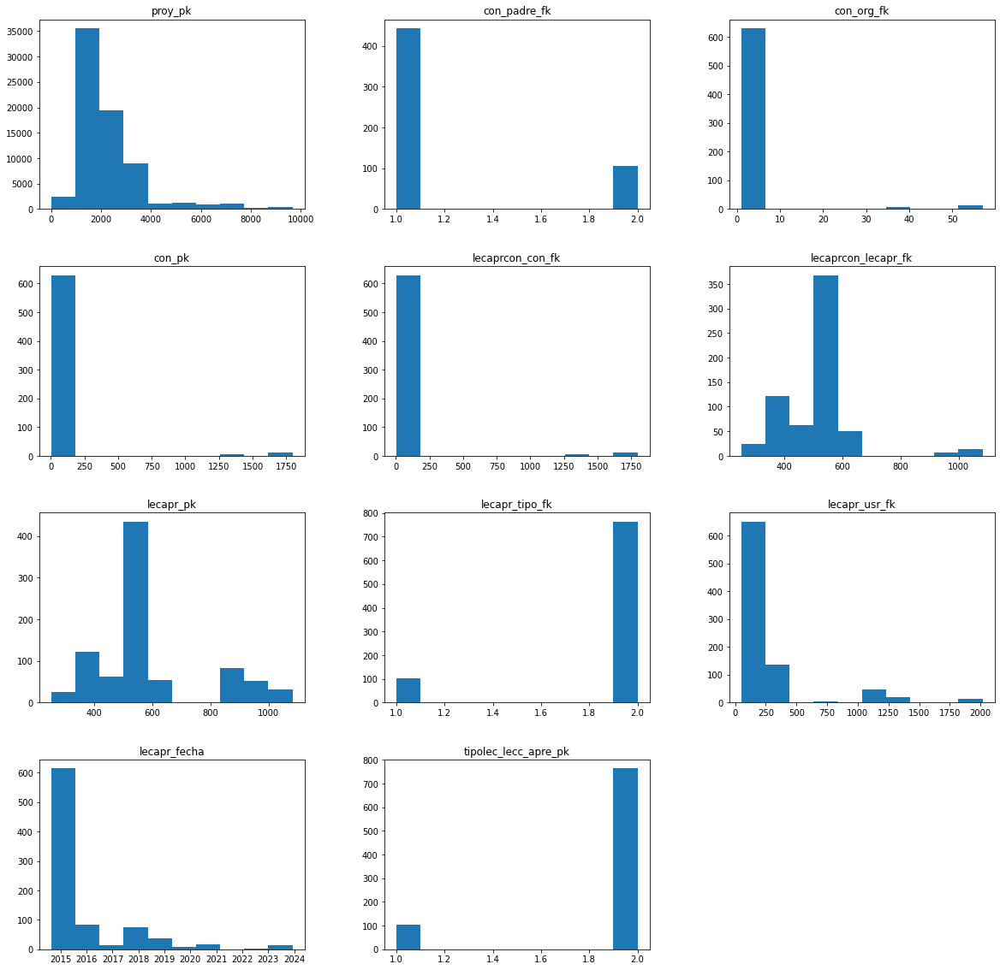

In [71]:
lecciones_app.hist(bins=10,figsize=(20,20),grid=False);

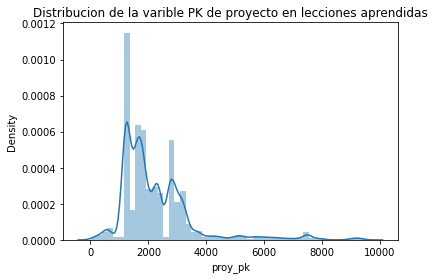

In [72]:
sns.distplot(lecciones_app['proy_pk'])
plt.title('Distribucion de la varible PK de proyecto en lecciones aprendidas')
plt.show()

(0.0, 2.05)

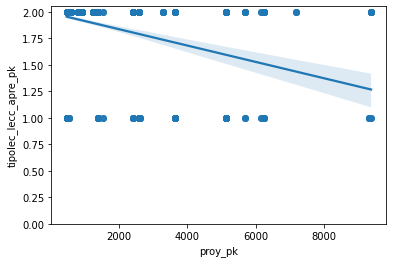

In [73]:
# View if there is a linear relation between continuous numerical variable Fare & target variable Survived.

sns.regplot(x = "proy_pk", y = "tipolec_lecc_apre_pk", data = lecciones_app)
plt.ylim(0,)

In [74]:
df_indice_recet1=lecciones_app.reset_index()

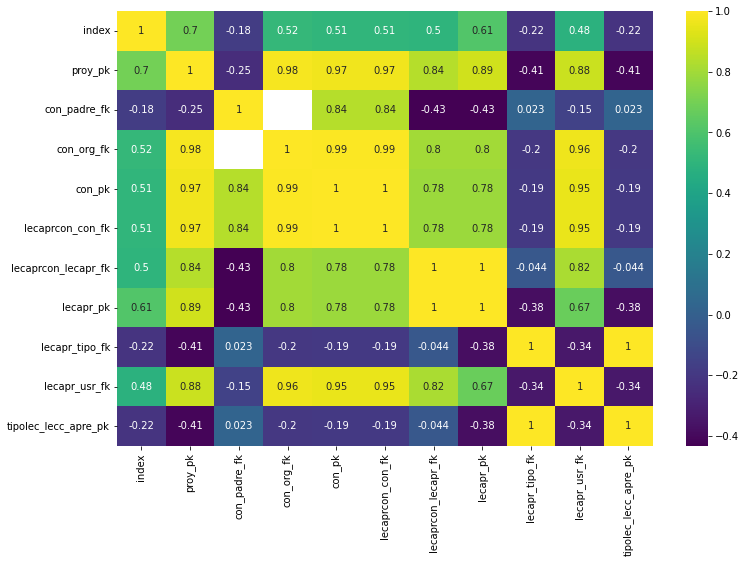

In [75]:
plt.figure(figsize=(12, 8))
sns.heatmap(df_indice_recet1.corr(), annot=True, cmap='viridis')
plt.show()

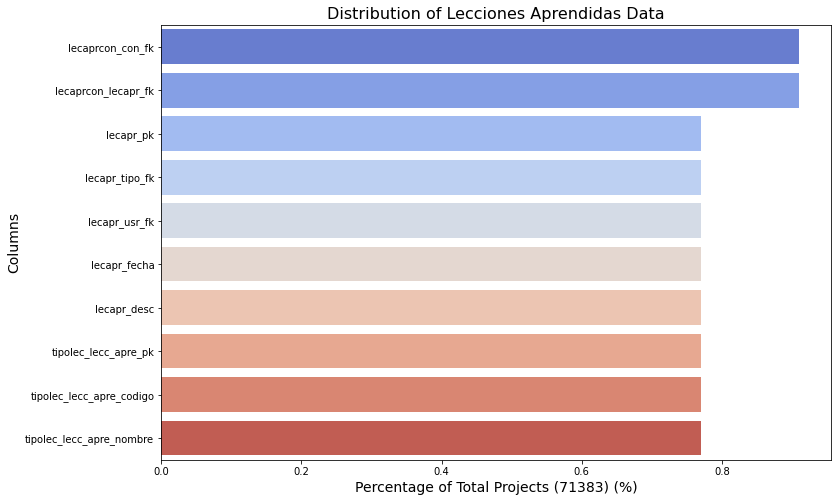

In [78]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd


data = {
    'Column': ['lecaprcon_con_fk', 'lecaprcon_lecapr_fk', 'lecapr_pk', 'lecapr_tipo_fk', 
               'lecapr_usr_fk', 'lecapr_fecha', 'lecapr_desc', 'tipolec_lecc_apre_pk', 
               'tipolec_lecc_apre_codigo', 'tipolec_lecc_apre_nombre'],
    'Percentage of Total Expected (%)': [100.0, 100.0, 95.0, 95.0, 95.0, 95.0, 95.0, 95.0, 95.0, 95.0],
    'Percentage of Total Projects (71383) (%)': [0.91, 0.91, 0.77, 0.77, 0.77, 0.77, 0.77, 0.77, 0.77, 0.77]
}

df_lecciones = pd.DataFrame(data)

# Crear la gráfica
plt.figure(figsize=(12, 8))
plt.title('Distribution of Lecciones Aprendidas Data', fontsize=16)

# Gráfico de barras con Seaborn
sns.barplot(data=df_lecciones, x='Percentage of Total Projects (71383) (%)', y='Column', palette='coolwarm')

# Personalizar etiquetas
plt.xlabel('Percentage of Total Projects (71383) (%)', fontsize=14)
plt.ylabel('Columns', fontsize=14)

# Mostrar la gráfica
plt.show()


Variables Categoricas repetir y evitar

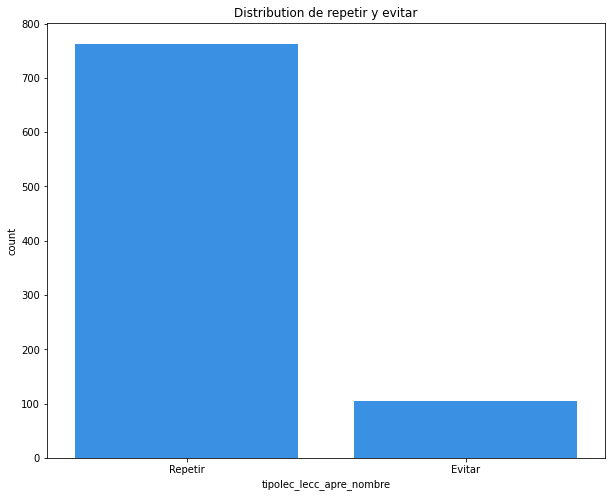

In [76]:
plt.figure(figsize=(10,8))
plt.title('Distribution de repetir y evitar')
d0 = sns.countplot(data=df_indice_recet1, x='tipolec_lecc_apre_nombre', color='dodgerblue')

In [77]:
data['tipolec_lecc_apre_nombre'].value_counts() 

Repetir    763
Evitar     104
Name: tipolec_lecc_apre_nombre, dtype: int64

It is observed that the lessons to repeat represent 88% of the total, therefore they have a positive orientation when carried out. While those to avoid represent 12%.

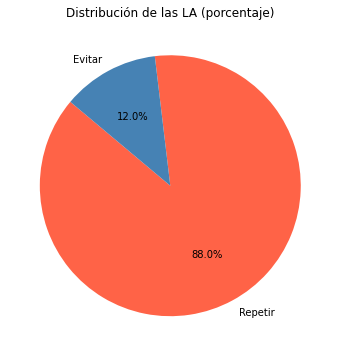

In [81]:
# Calcular los porcentajes
total = sum(values)
percentages = [value / total * 100 for value in values]

# Crear el gráfico de torta con porcentajes
plt.figure(figsize=(6,6))
plt.pie(percentages, labels=labels, colors=['#FF6347', '#4682B4'], autopct='%1.1f%%', startangle=140)
plt.title('Distribución de las LA (porcentaje)')

# Mostrar el gráfico
plt.show()



In [83]:
lecciones_app1 = lecciones_app[lecciones_app['lecapr_desc'].fillna('').str.contains('Involucrar|personas|organismo|personal|clave|motivado|tiempos|excesivos|implantaciones', case=False)]


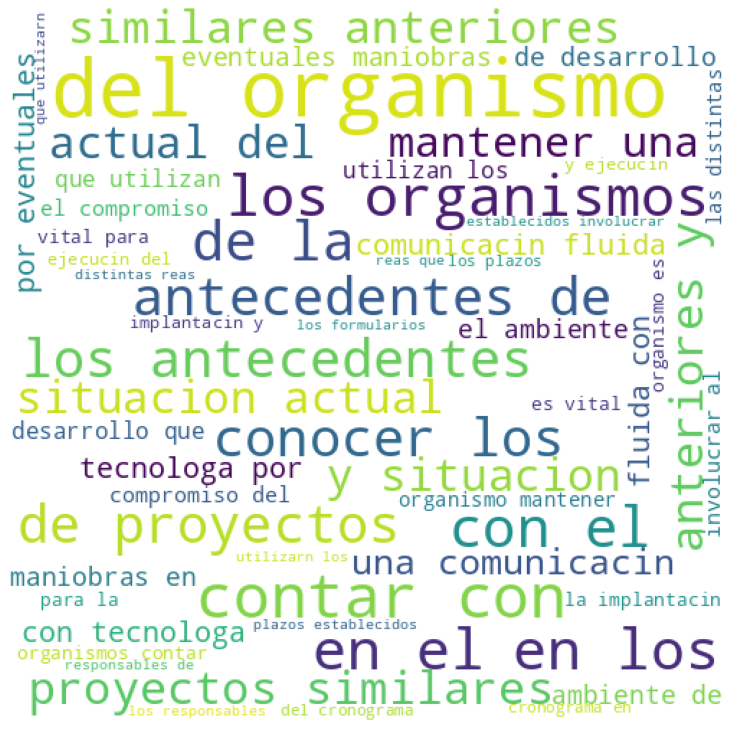

In [84]:
#Nube de palabras para “Group of weather parameters“.
# Python program to generate WordCloud
comment_words = ''
stopwords = set(STOPWORDS)
# iterate through the csv file
for val in lecciones_app1.lecapr_desc:
# typecaste each val to string
    val = str(val)
# split the value
    tokens = val.split()
# Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()   
    comment_words += " ".join(tokens)+" "
wordcloud = WordCloud(width = 500, height = 500,
                    background_color ='white',
                    stopwords = stopwords,
                    min_font_size = 10).generate(comment_words)
# plot the WordCloud image
plt.figure(figsize = (10, 10), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.show()

It is observed that the lessons learned have a high connection with the types of risks mentioned:
1. Involve people and the organization (fluid communication)
2. Have key personnel
3. Avoid spending excessive time
4. Avoid implementations by the organization
5. Motivate personnel

In [86]:
lecciones_app2 = lecciones_app[lecciones_app['con_nombre'].notna() & lecciones_app['con_nombre'].str.contains('Liderazgo|Humanos|Cronograma|Implantacin|Riesgos|Calidad|Costos|Alcance|Plazos|Comunicaciones|Requerimiento|Recursos', case=False)]


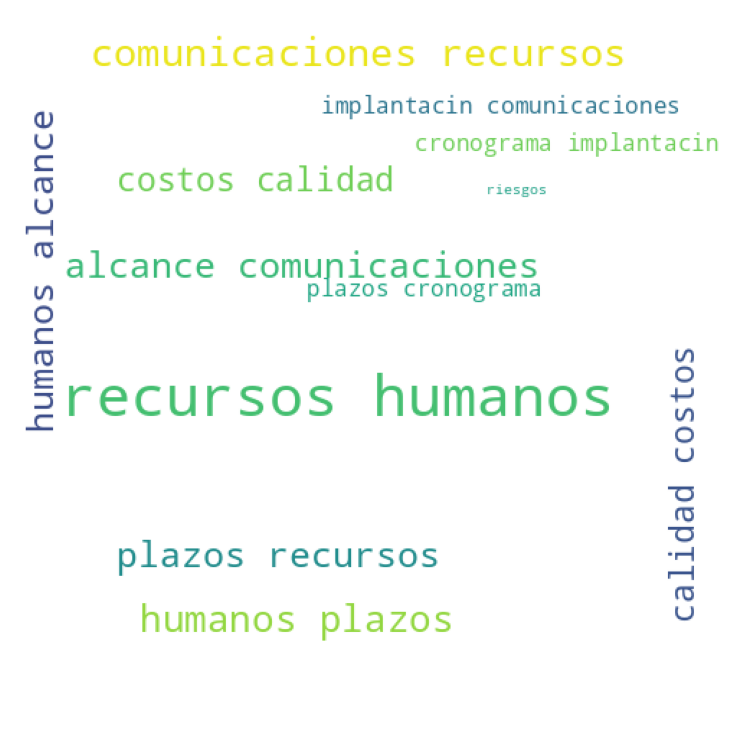

In [87]:
#Nube de palabras para “Group of weather parameters“.
# Python program to generate WordCloud
comment_words = ''
stopwords = set(STOPWORDS)
# iterate through the csv file
for val in lecciones_app2.con_nombre:
# typecaste each val to string
    val = str(val)
# split the value
    tokens = val.split()
# Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()   
    comment_words += " ".join(tokens)+" "
wordcloud = WordCloud(width = 500, height = 500,
                    background_color ='white',
                    stopwords = stopwords,
                    min_font_size = 10).generate(comment_words)
# plot the WordCloud image
plt.figure(figsize = (10, 10), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.show()

From the lessons learned, the areas of knowledge that stand out are:
1. Implementation schedule
2. Human Resources
3. Scope
4. Communications
5. Time (schedule, deadlines)
6. Risk
7. Quality
8. Costs


Conclusions

Low Impact of Lessons Learned and Schedules on Projects:

It is found out that only 1.21% of projects have at least one documented lesson learned, which is very low and shows the lack of utilization of one very important source of lessons learned in project management. What is more, only 0.91% of projects had at least one schedule, meaning a simple poor level of structured planning or a lack of documentation of work plans, but not relating to how good such schedules are.

Analysis Of Lessons Learned:

88% of the lessons learned are oriented to "Repeat," meaning that they are positive practices that should be done in future projects. Meanwhile, 12% of the lessons learned are focused on "Avoid," indicating aspects that have generated a negative outcome and should be avoided in the future.

Identification of Shared Patterns: The following are the five key words identified from the generated word cloud that replicate across 10 grouping categories, suggesting the existence of recurring themes and common areas of focus in lessons learned.

Recommendation:

This involves a review and enhancement of lessons learned in documentation, generation, and use. Currently, their low representation in project documentation could be inhibiting organizational learning and continuous improvement in project management. Strengthening the process will make sure lessons learned can be effectively identified, documented, and applied.

# Program Table Analysis

The EDA of programs is then carried out

In [123]:
# Assuming 'data' is your DataFrame
programa = data_final[['prog_activo','prog_area_fk', 'prog_descripcion','prog_est_fk','prog_fecha_act','prog_fecha_crea','prog_habilitado', 'prog_id_migrado',
    'prog_nombre','prog_obj_est_fk','prog_obj_publico','proy_pk','proy_prog_fk','prog_obj_publico','prog_objetivo','prog_org_fk','prog_pk',
    'prog_progindices_fk','prog_semaforo_amarillo','prog_semaforo_rojo','est_prog_codigo','est_prog_nombre','est_prog_orden_proceso','est_prog_pk']]


In [124]:
programa.info(verbose = True, null_counts = True, buf=None, max_cols=None, memory_usage=None, show_counts=None)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71383 entries, 0 to 183255
Data columns (total 24 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   prog_activo             66362 non-null  float64       
 1   prog_area_fk            66362 non-null  float64       
 2   prog_descripcion        53330 non-null  string        
 3   prog_est_fk             66362 non-null  float64       
 4   prog_fecha_act          66362 non-null  datetime64[ns]
 5   prog_fecha_crea         64352 non-null  datetime64[ns]
 6   prog_habilitado         66362 non-null  float64       
 7   prog_id_migrado         2010 non-null   float64       
 8   prog_nombre             66362 non-null  string        
 9   prog_obj_est_fk         38159 non-null  float64       
 10  prog_obj_publico        53853 non-null  string        
 11  proy_pk                 71383 non-null  int64         
 12  proy_prog_fk            66362 non-null  float

In [119]:
import pandas as pd

# Simulación de datos para 'programa'
data = {
    'prog_activo': [None] * 50321 + [1.0] * 21062,
    'prog_area_fk': [None] * 50321 + [1.0] * 21062,
    'prog_descripcion': [None] * 18053 + ['desc'] * 53330,
    'prog_est_fk': [None] * 50321 + [1.0] * 21062,
    'prog_fecha_act': [None] * 50321 + [pd.Timestamp('2021-01-01')] * 21062,
    'prog_fecha_crea': [None] * 7031 + [pd.Timestamp('2021-01-01')] * 64352,
    'prog_habilitado': [None] * 50321 + [1.0] * 21062,
    'prog_id_migrado': [None] * 69373 + [1.0] * 2010,
    'prog_nombre': [None] * 50321 + ['nombre'] * 21062,
    'prog_obj_est_fk': [None] * 33224 + [1.0] * 38159,
    'prog_obj_publico': [None] * 17530 + ['publico'] * 53853,
    'proy_pk': list(range(71383)),
    'proy_prog_fk': [None] * 50321 + [1.0] * 21062,
    'prog_objetivo': [None] * 6081 + ['objetivo'] * 65302,
    'prog_org_fk': [None] * 50321 + [1.0] * 21062,
    'prog_pk': [None] * 50321 + [1.0] * 21062,
}

programa = pd.DataFrame(data)

# Lista de columnas para analizar
columns_to_analyze_programa = [
    'prog_activo', 'prog_area_fk', 'prog_descripcion', 'prog_est_fk',
    'prog_fecha_act', 'prog_fecha_crea', 'prog_habilitado', 'prog_id_migrado',
    'prog_nombre', 'prog_obj_est_fk', 'prog_obj_publico', 'proy_pk',
    'proy_prog_fk', 'prog_objetivo', 'prog_org_fk', 'prog_pk'
]

# Valores de referencia
expected_counts = {col: 71383 for col in columns_to_analyze_programa}

# Cálculos
difference_programa = {col: expected_counts[col] - programa[col].count() for col in columns_to_analyze_programa}
percentage_programa = {col: (programa[col].count() / expected_counts[col]) * 100 for col in columns_to_analyze_programa}
percentage_total_projects_programa = {col: (programa[col].count() / 71383) * 100 for col in columns_to_analyze_programa}

# Crear DataFrame con resultados
result_programa = pd.DataFrame({
    'Column': columns_to_analyze_programa,
    'Record Count': [programa[col].count() for col in columns_to_analyze_programa],
    'Difference from Expected': [difference_programa[col] for col in columns_to_analyze_programa],
    'Percentage of Total Expected (%)': [percentage_programa[col] for col in columns_to_analyze_programa],
    'Percentage of Total Projects (71383) (%)': [percentage_total_projects_programa[col] for col in columns_to_analyze_programa]
})

# Ajustar el DataFrame para mejor visualización
result_programa = result_programa.reset_index(drop=True)
result_programa.index += 1  # Inicia el índice en 1 en lugar de 0
result_programa.columns = ['Column', 'Record Count', 'Difference from Expected', 'Percentage of Total Expected (%)', 'Percentage of Total Projects (71383) (%)']

# Aplicar estilo para mejorar la visualización
styled_result_programa = result_programa.style.format({
    'Record Count': '{:,.0f}',
    'Difference from Expected': '{:,.0f}',
    'Percentage of Total Expected (%)': '{:.2f}%',
    'Percentage of Total Projects (71383) (%)': '{:.2f}%'
}).background_gradient(subset=['Difference from Expected'], cmap='Blues')\
   .set_properties(**{
       'border': '1px solid black',
       'padding': '5px',
       'text-align': 'center',
       'background-color': '#f5f5f5',  # Color de fondo claro para mejorar la visibilidad
       'color': 'black'  # Color de texto negro para mejor contraste
   }).set_table_styles([
       {'selector': 'thead th', 'props': [('background-color', '#2a3f5f'), ('color', 'white'), ('text-align', 'center')]},
       {'selector': 'tbody td', 'props': [('background-color', '#f5f5f5')]}  # Fondo claro para el cuerpo
   ])

# Mostrar la tabla estilizada
styled_result_programa



,Column,Record Count,Difference from Expected,Percentage of Total Expected (%),Percentage of Total Projects (71383) (%)
1,prog_activo,"21,062","50,321",29.51%,29.51%
2,prog_area_fk,"21,062","50,321",29.51%,29.51%
3,prog_descripcion,"53,330","18,053",74.71%,74.71%
4,prog_est_fk,"21,062","50,321",29.51%,29.51%
5,prog_fecha_act,"21,062","50,321",29.51%,29.51%
6,prog_fecha_crea,"64,352","7,031",90.15%,90.15%
7,prog_habilitado,"21,062","50,321",29.51%,29.51%
8,prog_id_migrado,"2,010","69,373",2.82%,2.82%
9,prog_nombre,"21,062","50,321",29.51%,29.51%
10,prog_obj_est_fk,"38,159","33,224",53.46%,53.46%


30% are programs that contain projects that average approximately 3 projects per program.
On average, each program has 3 objectives.

In [130]:
programa.sample(5)

,prog_activo,prog_area_fk,prog_descripcion,prog_est_fk,prog_fecha_act,prog_fecha_crea,prog_habilitado,prog_id_migrado,prog_nombre,prog_obj_est_fk,...,prog_objetivo,prog_org_fk,prog_pk,prog_progindices_fk,prog_semaforo_amarillo,prog_semaforo_rojo,est_prog_codigo,est_prog_nombre,est_prog_orden_proceso,est_prog_pk
39825,1.0,124.0,<NA>,3.0,2019-12-12,2015-10-22,1.0,NaN,Desarrollo de la infraestructura vial departam...,NaN,...,p strongObjetivo Generalstrongp p Mejorar la d...,6.0,205.0,213.0,10.0,20.0,PLANIFICACION,Planificacion,3.0,3.0
10688,1.0,126.0,pp,11.0,2019-07-05,2015-10-22,1.0,NaN,Mejora de los servicios en el territorio,66.0,...,p Objetivo Generalp p Mejorar la dotacin acces...,6.0,206.0,214.0,30.0,40.0,PENDIENTEPMOT,Pendiente PMO T,-1.0,11.0
68813,1.0,121.0,p Este componente busca apoyar a los municipio...,12.0,2018-12-24,2015-10-22,1.0,NaN,Fortalecimiento de capacidades de los gobierno...,67.0,...,p El objetivo del componente es fortalecer las...,6.0,203.0,212.0,180.0,200.0,PENDIENTEPMOF,Pendiente PMO F,0.0,12.0
23820,1.0,124.0,pp,4.0,2020-02-12,2016-03-09,1.0,NaN,Electrificacin rural,NaN,...,p Brindar acceso al servicio de energa elctric...,6.0,251.0,260.0,20.0,30.0,EJECUCION,Ejecucion,4.0,4.0
70788,1.0,126.0,pp,11.0,2019-07-05,2015-10-22,1.0,NaN,Mejora de los servicios en el territorio,66.0,...,p Objetivo Generalp p Mejorar la dotacin acces...,6.0,206.0,214.0,30.0,40.0,PENDIENTEPMOT,Pendiente PMO T,-1.0,11.0


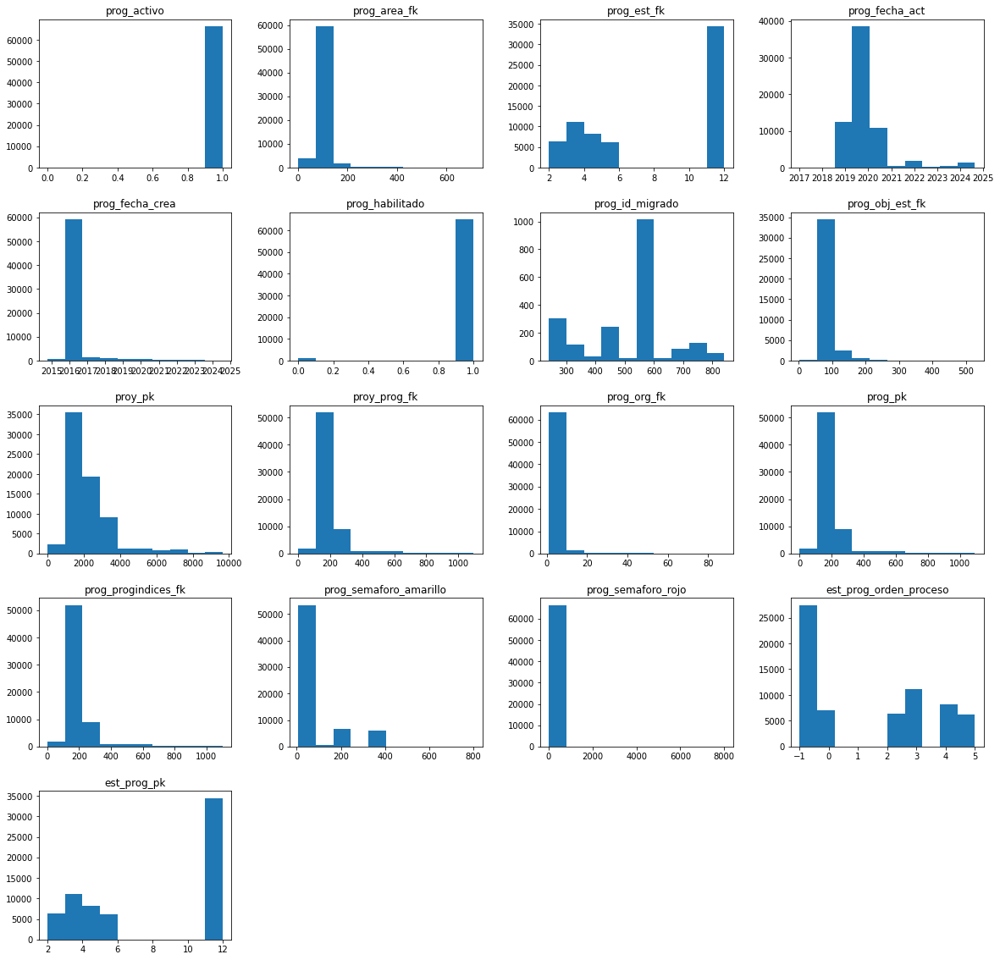

In [131]:
programa.hist(bins=10,figsize=(20,20),grid=False);

In [ ]:
#Drop irrelevant columns in train data

drop_cols = ['prog_semaforo_amarillo','prog_semaforo_rojo','prog_activo','prog_id_migrado',]
programa.drop(drop_cols, axis = 1, inplace = True)

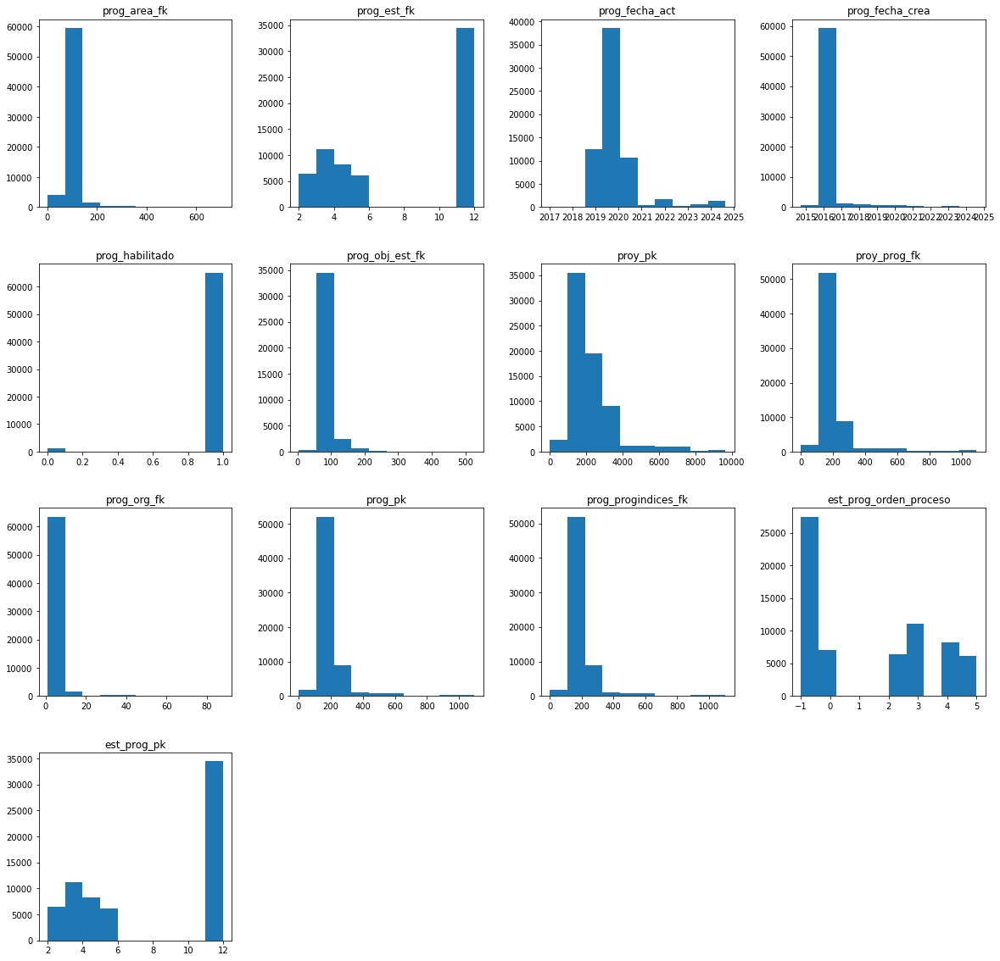

In [135]:
programa.hist(bins=10,figsize=(20,20),grid=False);

In [136]:
df_indice_recet4=programa.reset_index()

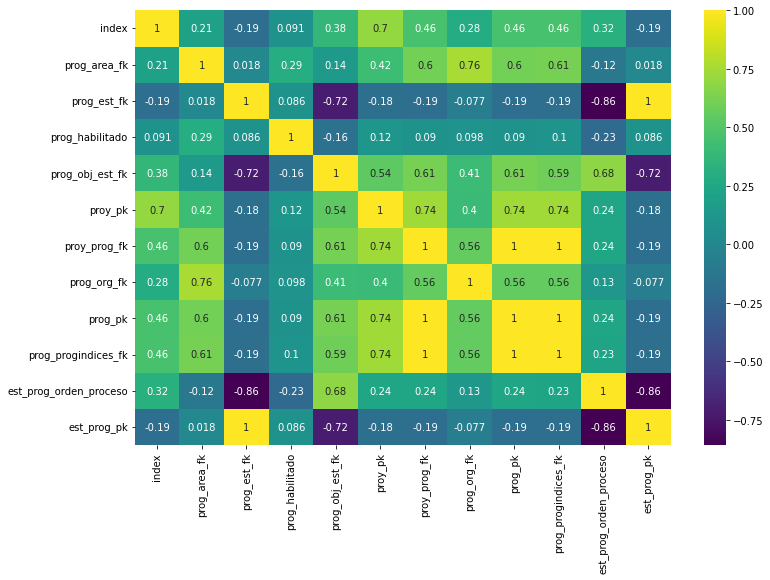

In [137]:
plt.figure(figsize=(12, 8))
sns.heatmap(df_indice_recet4.corr(), annot=True, cmap='viridis')
plt.show()

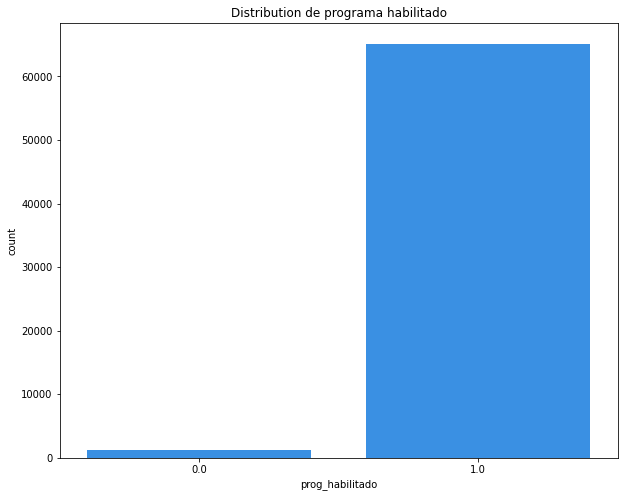

In [138]:
plt.figure(figsize=(10,8))
plt.title('Distribution de programa habilitado')
d0 = sns.countplot(data=df_indice_recet4, x='prog_habilitado', color='dodgerblue')

In [139]:
df_indice_recet4['prog_habilitado'].value_counts() 

1.0    65132
0.0     1230
Name: prog_habilitado, dtype: int64

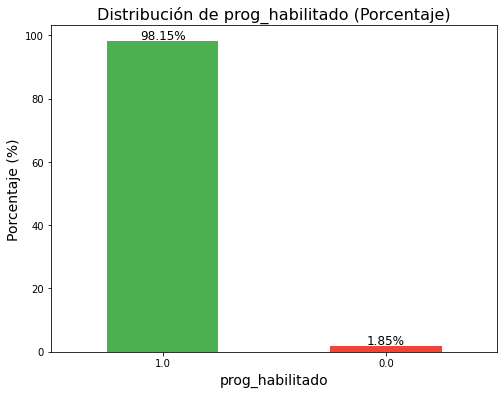

In [141]:
# Calcular el porcentaje
prog_habilitado_percentage = (prog_habilitado_series / prog_habilitado_series.sum()) * 100

# Crear una gráfica de barras para los porcentajes
plt.figure(figsize=(8, 6))
prog_habilitado_percentage.plot(kind='bar', color=['#4CAF50', '#F44336'])

# Añadir etiquetas y título
plt.title('Distribución de prog_habilitado (Porcentaje)', fontsize=16)
plt.xlabel('prog_habilitado', fontsize=14)
plt.ylabel('Porcentaje (%)', fontsize=14)
plt.xticks(rotation=0)
plt.ylim(0, max(prog_habilitado_percentage) + 5)

# Mostrar los valores en las barras
for i, v in enumerate(prog_habilitado_percentage):
    plt.text(i, v + 0.5, f'{v:.2f}%', ha='center', fontsize=12)

# Mostrar la gráfica
plt.show()


98.15% of the programs are enabled.

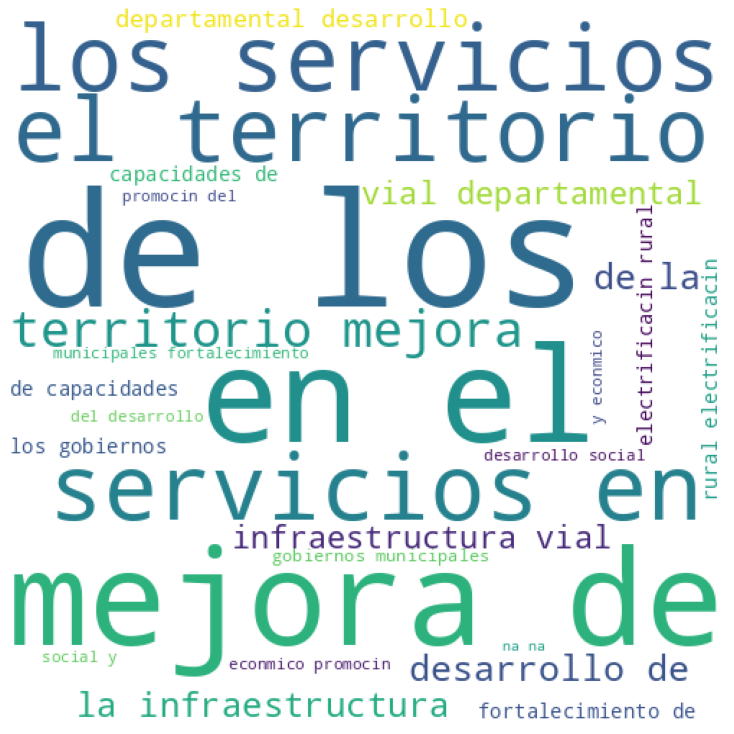

In [142]:
#Nube de palabras para “Group of weather parameters“.
# Python program to generate WordCloud
comment_words = ''
stopwords = set(STOPWORDS)
# iterate through the csv file
for val in df_indice_recet4.prog_nombre:
# typecaste each val to string
    val = str(val)
# split the value
    tokens = val.split()
# Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()   
    comment_words += " ".join(tokens)+" "
wordcloud = WordCloud(width = 500, height = 500,
                    background_color ='white',
                    stopwords = stopwords,
                    min_font_size = 10).generate(comment_words)
# plot the WordCloud image
plt.figure(figsize = (10, 10), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.show()

The programs with the largest number of projects are:

1. Services
2. Strengthening of Infrastructure

# Dataset Analysis, Risk-Free,Lessons Learned and Programs

In [204]:
# Crear el DataFrame original sin las columnas de riesgos, lecciones aprendidas y programas
completo = data_final.drop(columns=[
    # Columnas de riesgos
    'risk_pk', 'risk_nombre', 'risk_fecha_actu', 'risk_probabilidad', 'risk_impacto', 
    'risk_ent_fk', 'risk_fecha_limite', 'risk_efecto', 'risk_estategia', 'risk_disparador', 
    'risk_contingencia', 'risk_fecha_superado', 'risk_usuario_superado_fk', 'risk_exposicion',
    
    # Columnas de lecciones aprendidas
    'con_padre_fk', 'con_org_fk', 'con_nombre', 'con_pk', 'lecaprcon_con_fk', 
    'lecaprcon_lecapr_fk', 'lecapr_pk', 'lecapr_tipo_fk', 'lecapr_usr_fk', 'lecapr_fecha', 
    'lecapr_desc', 'tipolec_lecc_apre_pk', 'tipolec_lecc_apre_codigo', 'tipolec_lecc_apre_nombre',
    
    # Columnas de programas
    'prog_activo', 'prog_area_fk', 'prog_descripcion', 'prog_est_fk', 'prog_fecha_act', 
    'prog_fecha_crea', 'prog_habilitado', 'prog_id_migrado', 'prog_nombre', 'prog_obj_est_fk', 
    'prog_obj_publico', 'proy_prog_fk', 'prog_objetivo', 'prog_org_fk', 'prog_pk', 
    'prog_progindices_fk', 'prog_semaforo_amarillo', 'prog_semaforo_rojo', 'est_prog_codigo', 
    'est_prog_nombre', 'est_prog_orden_proceso', 'est_prog_pk',

    # columnas inecesarias
    'area_abreviacion', 'area_director', 'area_habilitada', 'area_nombre', 'area_version', 
    'risk_contingencia', 'risk_disparador', 'risk_efecto', 'risk_ent_fk', 'risk_estategia', 
    'risk_exposicion', 'risk_fecha_limite', 'risk_fecha_superado', 'risk_impacto', 'risk_nombre', 
    'risk_pk', 'risk_probabilidad', 'risk_usuario_superado_fk', 'risk_version', 
    'tipolec_lecc_apre_codigo', 'tipolec_lecc_apre_nombre', 'tipolec_lecc_apre_pk', 
    'lecapr_pk', 'lecapr_tipo_fk', 'lecapr_usr_fk','ent_coord_usu_fk', 'fue_version', 'int_version', 'obj_est_prog_descripcion', 
    'obj_est_prog_habilitado', 'obj_est_prog_nombre', 'obj_est_prog_pk', 'part_ent_fk', 
    'part_horas_plan', 'part_pk', 'part_usu_fk', 'prog_usu_id_gerente', 
    'prog_usu_primer_nombre_gerente', 'proy_usr_adjunto_fk', 'proy_usr_gerente_fk', 
    'proy_usr_pmofed_fk', 'proy_usr_sponsor_fk', 'proy_usu_adjunto_id', 
    'proy_usu_adjunto_primer_nombre', 'proy_usu_gerente_id', 'proy_usu_gerente_primer_nombre', 
    'proy_usu_pmofed_id', 'proy_usu_pmofed_primer_apellido', 'proy_usu_pmofed_primer_nombre', 
    'proy_usu_sponsor_id', 'proy_usu_sponsor_primer_apellido', 'proy_usu_sponsor_primer_nombre', 
    'proyint_version'
    
])

# Mostrar las primeras filas del DataFrame resultante
completo.head()



,area_pk,cro_proy_ent_seleccionado,cro_proy_permiso_escritura_padre,ent_cro_fk,ent_descripcion,ent_duracion,ent_duracion_linea_base,ent_esfuerzo,ent_fin,ent_fin_linea_base,...,proyind_fase_color,proyind_fecha_act,proyind_fecha_act_color,proyind_metodo_estado,proyind_metodo_sin_aprobar,proyind_periodo_fin,proyind_periodo_inicio,proyind_riesgo_alto,proyind_riesgo_expo,proyind_riesgo_ultact
0,1,0.0,1.0,NaN,<NA>,NaN,NaN,NaN,NaN,NaN,...,0,2019-10-09,4,0.00,0,2009-09-02,2009-01-23 00:00:00,0,NaN,NaT
1,4,0.0,1.0,NaN,<NA>,NaN,NaN,NaN,NaN,NaN,...,0,2019-10-09,4,30.43,0,2010-04-22,2009-03-01 00:00:00,0,NaN,NaT
2,1,0.0,1.0,NaN,<NA>,NaN,NaN,NaN,NaN,NaN,...,0,2019-10-09,4,0.00,0,2010-05-19,2009-01-01 00:00:00,0,NaN,NaT
3,1,0.0,1.0,NaN,<NA>,NaN,NaN,NaN,NaN,NaN,...,0,2019-10-09,4,0.00,0,2010-01-22,2009-01-01 00:00:00,0,NaN,NaT
4,1,0.0,1.0,NaN,<NA>,NaN,NaN,NaN,NaN,NaN,...,0,2019-10-09,4,0.00,0,2010-02-01,2008-12-08 00:00:00,0,NaN,NaT


In [227]:
completo.info(verbose = True, null_counts = True, buf=None, max_cols=None, memory_usage=None, show_counts=None)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71383 entries, 0 to 183255
Data columns (total 78 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   area_pk                           71383 non-null  int64         
 1   cro_proy_ent_seleccionado         70964 non-null  float64       
 2   cro_proy_permiso_escritura_padre  71038 non-null  float64       
 3   ent_cro_fk                        11248 non-null  float64       
 4   ent_descripcion                   676 non-null    string        
 5   ent_duracion                      11248 non-null  float64       
 6   ent_duracion_linea_base           11248 non-null  float64       
 7   ent_esfuerzo                      11248 non-null  float64       
 8   ent_fin                           11248 non-null  float64       
 9   ent_fin_linea_base                11248 non-null  float64       
 10  ent_id                            11248 non-n

In [206]:
import pandas as pd

# Suponiendo que el DataFrame se llama 'dataframe'
dataframe = completo

# Lista de columnas para analizar (ajustada según tus necesidades)
columns_to_analyze = [
    'area_pk', 'cro_proy_ent_seleccionado', 'cro_proy_permiso_escritura_padre', 'ent_cro_fk', 
    'ent_descripcion', 'ent_duracion', 'ent_duracion_linea_base', 'ent_esfuerzo', 
    'ent_fin', 'ent_fin_linea_base', 'ent_id', 'ent_inicio', 'ent_inicio_linea_base', 'ent_nivel', 
    'ent_nombre', 'ent_parent', 'ent_pk', 'ent_predecesor_fk', 'ent_progreso', 'ent_relevante', 
    'est_proy_codigo', 'est_proy_nombre', 'est_proy_orden_prroceso', 'est_proy_pk', 'fue_habilitada', 
    'fue_nombre', 'fue_pk', 'mon_proy_nombre', 'mon_proy_pk', 'mon_proy_signo', 
    'mon_proy_version', 'obj_est_proy_descripcion', 'obj_est_proy_habilitado', 'obj_est_proy_nombre', 
    'obj_est_proy_org_fk', 'org_nombre', 'pre_base', 'pre_fuente_organi_fk', 'pre_moneda', 
    'proy_activo', 'proy_area_fk', 'proy_cro_fk', 'proy_descripcion', 'proy_est_fk', 
    'proy_factor_impacto', 'proy_fecha_act', 'proy_fecha_act_pub', 'proy_fecha_crea', 
    'proy_fecha_est_act', 'proy_nombre', 'proy_obj_est_fk', 'proy_obj_publico', 'proy_objetivo', 
    'proy_otr_dat_fk', 'proy_otr_est_pub_fk', 'proy_otr_eta_fk', 'proy_peso', 
    'proy_pk', 'proy_pre_fk', 'proy_proyindices_fk', 'proy_publicable', 
    'proy_semaforo_amarillo', 'proy_semaforo_rojo', 'proy_situacion_actual', 'proyind_anvance_fin_rojo', 
    'proyind_anvance_par_rojo', 'proyind_avance_fin_azul', 'proyind_avance_par_azul', 
    'proyind_fase_color', 'proyind_fecha_act', 'proyind_fecha_act_color', 
    'proyind_metodo_estado', 'proyind_metodo_sin_aprobar', 'proyind_periodo_fin', 
    'proyind_periodo_inicio', 'proyind_riesgo_alto', 'proyind_riesgo_expo', 'proyind_riesgo_ultact'
]

# Valores de referencia (todos deberían ser 71383)
expected_counts = {col: 71383 for col in columns_to_analyze}

# Cálculos
difference = {col: expected_counts[col] - dataframe[col].count() for col in columns_to_analyze}
percentage = {col: (dataframe[col].count() / expected_counts[col]) * 100 for col in columns_to_analyze}
percentage_total_projects = {col: (dataframe[col].count() / 71383) * 100 for col in columns_to_analyze}

# Crear DataFrame con resultados
result = pd.DataFrame({
    'Column': columns_to_analyze,
    'Record Count': [dataframe[col].count() for col in columns_to_analyze],
    'Difference from Expected': [difference[col] for col in columns_to_analyze],
    'Percentage of Total Expected (%)': [percentage[col] for col in columns_to_analyze],
    'Percentage of Total Projects (71383) (%)': [percentage_total_projects[col] for col in columns_to_analyze]
})

# Ajustar el DataFrame para mejor visualización
result = result.reset_index(drop=True)
result.index += 1  # Inicia el índice en 1 en lugar de 0
result.columns = ['Column', 'Record Count', 'Difference from Expected', 'Percentage of Total Expected (%)', 'Percentage of Total Projects (71383) (%)']

# Aplicar estilo para mejorar la visualización
styled_result = result.style.format({
    'Record Count': '{:,.0f}',
    'Difference from Expected': '{:,.0f}',
    'Percentage of Total Expected (%)': '{:.2f}%',
    'Percentage of Total Projects (71383) (%)': '{:.2f}%'
}).background_gradient(subset=['Difference from Expected'], cmap='Blues')\
   .set_properties(**{
       'border': '1px solid black',
       'padding': '5px',
       'text-align': 'center',
       'background-color': '#f5f5f5',  # Color de fondo claro para mejorar la visibilidad
       'color': 'black'  # Color de texto negro para mejor contraste
   }).set_table_styles([
       {'selector': 'thead th', 'props': [('background-color', '#2a3f5f'), ('color', 'white'), ('text-align', 'center')]},
       {'selector': 'tbody td', 'props': [('background-color', '#f5f5f5')]}  # Fondo claro para el cuerpo
   ])

# Mostrar la tabla estilizada
styled_result



,Column,Record Count,Difference from Expected,Percentage of Total Expected (%),Percentage of Total Projects (71383) (%)
1,area_pk,"71,383",0,100.00%,100.00%
2,cro_proy_ent_seleccionado,"70,964",419,99.41%,99.41%
3,cro_proy_permiso_escritura_padre,"71,038",345,99.52%,99.52%
4,ent_cro_fk,"11,248","60,135",15.76%,15.76%
5,ent_descripcion,676,"70,707",0.95%,0.95%
6,ent_duracion,"11,248","60,135",15.76%,15.76%
7,ent_duracion_linea_base,"11,248","60,135",15.76%,15.76%
8,ent_esfuerzo,"11,248","60,135",15.76%,15.76%
9,ent_fin,"11,248","60,135",15.76%,15.76%
10,ent_fin_linea_base,"11,248","60,135",15.76%,15.76%


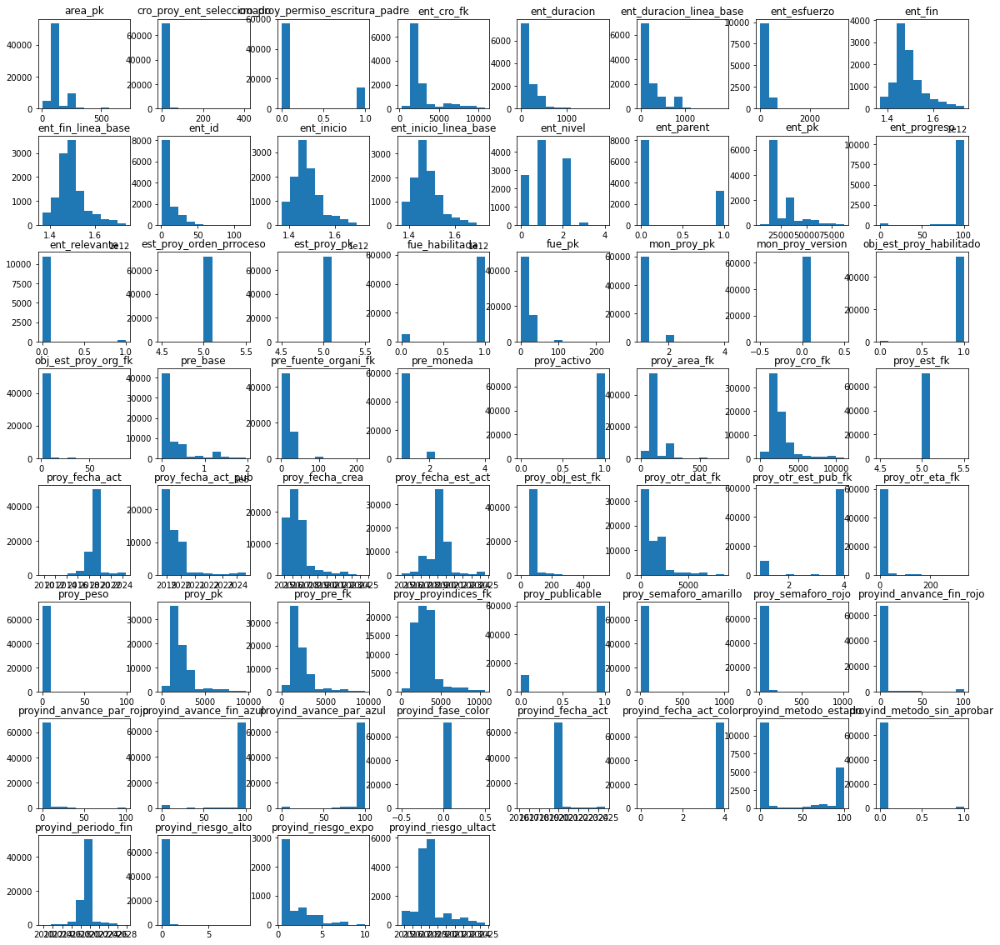

In [208]:
completo.hist(bins=10,figsize=(20,20),grid=False);

In [209]:
completo_corr = completo.corr().transpose()
completo_corr

,area_pk,cro_proy_ent_seleccionado,cro_proy_permiso_escritura_padre,ent_cro_fk,ent_duracion,ent_duracion_linea_base,ent_esfuerzo,ent_fin,ent_fin_linea_base,ent_id,...,proyind_anvance_fin_rojo,proyind_anvance_par_rojo,proyind_avance_fin_azul,proyind_avance_par_azul,proyind_fase_color,proyind_fecha_act_color,proyind_metodo_estado,proyind_metodo_sin_aprobar,proyind_riesgo_alto,proyind_riesgo_expo
area_pk,1.000000,-0.021512,-0.278217,0.245468,-0.024061,-0.076755,-0.070045,0.189508,0.180760,0.071987,...,0.017991,0.000732,-0.036592,-0.028983,NaN,0.006352,-0.045202,-0.092429,0.037823,-0.040445
cro_proy_ent_seleccionado,-0.021512,1.000000,0.178840,-0.325057,-0.195072,0.125743,0.223519,-0.322071,-0.237807,0.496458,...,-0.022416,0.004199,0.022817,-0.000370,NaN,0.002088,0.585665,0.036008,0.057873,-0.433508
cro_proy_permiso_escritura_padre,-0.278217,0.178840,1.000000,-0.274551,-0.082406,-0.187454,-0.033120,-0.274813,-0.339097,0.185394,...,-0.010110,0.031654,0.014417,-0.018907,NaN,-0.007626,0.228390,0.085098,0.028484,0.441786
ent_cro_fk,0.245468,-0.325057,-0.274551,1.000000,0.291871,0.042331,-0.027332,0.888094,0.866267,-0.213735,...,0.397048,0.341248,-0.443782,-0.390747,NaN,NaN,-0.342676,0.112792,0.206811,0.213222
ent_duracion,-0.024061,-0.195072,-0.082406,0.291871,1.000000,0.571658,0.208248,0.411513,0.375467,-0.278294,...,0.155729,0.126749,-0.185997,-0.157746,NaN,NaN,-0.232474,0.015364,0.203140,0.099006
ent_duracion_linea_base,-0.076755,0.125743,-0.187454,0.042331,0.571658,1.000000,0.638963,0.048582,0.273515,-0.328008,...,0.041599,0.031543,-0.058362,-0.048467,NaN,NaN,0.192948,-0.027828,0.101286,-0.351611
ent_esfuerzo,-0.070045,0.223519,-0.033120,-0.027332,0.208248,0.638963,1.000000,-0.020794,0.163714,-0.273160,...,0.011253,-0.014014,-0.029113,-0.013060,NaN,NaN,0.314008,-0.078892,0.080844,-0.276614
ent_fin,0.189508,-0.322071,-0.274813,0.888094,0.411513,0.048582,-0.020794,1.000000,0.952514,-0.077096,...,0.338244,0.290337,-0.389274,-0.344737,NaN,NaN,-0.438843,0.096897,0.193228,0.260102
ent_fin_linea_base,0.180760,-0.237807,-0.339097,0.866267,0.375467,0.273515,0.163714,0.952514,1.000000,-0.130561,...,0.325866,0.280360,-0.376376,-0.333971,NaN,NaN,-0.325662,0.084775,0.188950,0.128365
ent_id,0.071987,0.496458,0.185394,-0.213735,-0.278294,-0.328008,-0.273160,-0.077096,-0.130561,1.000000,...,-0.089820,-0.078007,0.098438,0.086413,NaN,NaN,-0.106757,-0.005022,-0.036258,0.029682


In [232]:
# Supongamos que 'completo' es tu DataFrame real que contiene la matriz de correlación

# Calcular la matriz de correlación
correlation_matrix = completo.corr()

# Obtener las correlaciones con 'proy_pk'
correlation_with_proy_pk = correlation_matrix['proy_pk'].sort_values(ascending=False)

# Convertir en un DataFrame para mejor visualización
df_correlations = correlation_with_proy_pk.reset_index()
df_correlations.columns = ['Variable', 'Correlación']

# Resaltar valores mayores a 0.5 o menores a -0.5
def highlight_high_correlations(val):
    color = 'blue' if val >= 0.5 or val <= -0.5 else ''
    return f'background-color: {color}'

# Aplicar el formato y mostrar la tabla
df_correlations.style.applymap(highlight_high_correlations, subset=['Correlación'])


,Variable,Correlación
0,proy_pk,1.000000
1,proy_pre_fk,0.999274
2,ent_cro_fk,0.997083
3,proy_otr_dat_fk,0.994377
4,proy_proyindices_fk,0.994267
5,proy_cro_fk,0.993657
6,ent_pk,0.986014
7,ent_fin,0.885155
8,ent_inicio_linea_base,0.875808
9,ent_inicio,0.875455


In [210]:
df_indice_recet3=completo.reset_index()

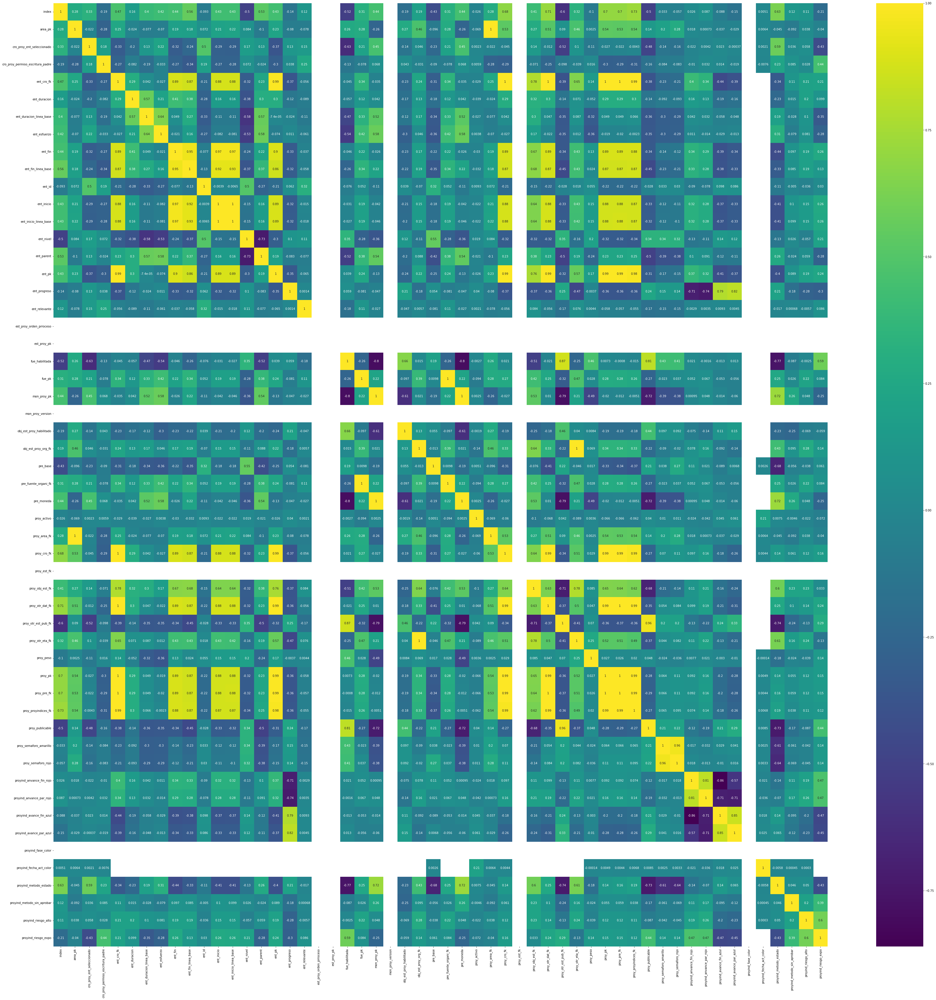

In [211]:
plt.figure(figsize=(60, 60))
sns.heatmap(df_indice_recet3.corr(), annot=True, cmap='viridis')
plt.show()

Take into account that only active and completed projects are found, which are the requirements to belong to this data set. And anonymized because we are not interested in the names of the data.

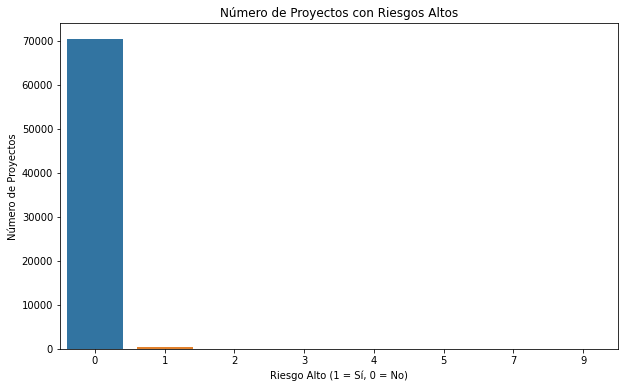

In [214]:
# Gráfico de barras para riesgos asociados a los proyectos
plt.figure(figsize=(10, 6))
sns.countplot(data=dataframe, x='proyind_riesgo_alto')
plt.title('Número de Proyectos con Riesgos Altos')
plt.xlabel('Riesgo Alto (1 = Sí, 0 = No)')
plt.ylabel('Número de Proyectos')
plt.show()




The chart indicates that only a very small fraction of the total projects are associated with high risks, while the overwhelming majority are not.

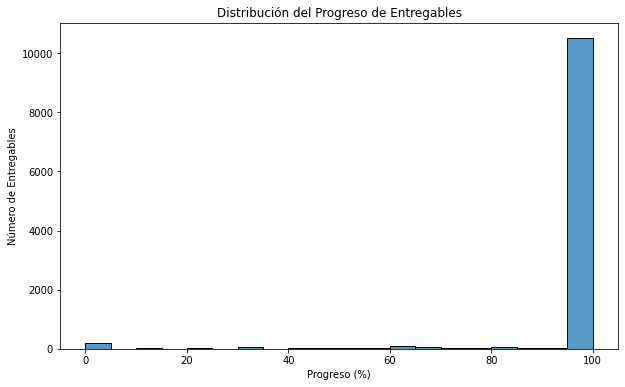

In [215]:
# Histograma para el progreso de los entregables
plt.figure(figsize=(10, 6))
sns.histplot(data=dataframe, x='ent_progreso', bins=20)
plt.title('Distribución del Progreso de Entregables')
plt.xlabel('Progreso (%)')
plt.ylabel('Número de Entregables')
plt.show()


Looking at the graph, it is noticeable that there are almost no deliverables with intermediate progress (e.g. 20%, 40%, 60%, etc.), which could indicate that once started, projects tend to be fully completed before being recorded or updated in the system.

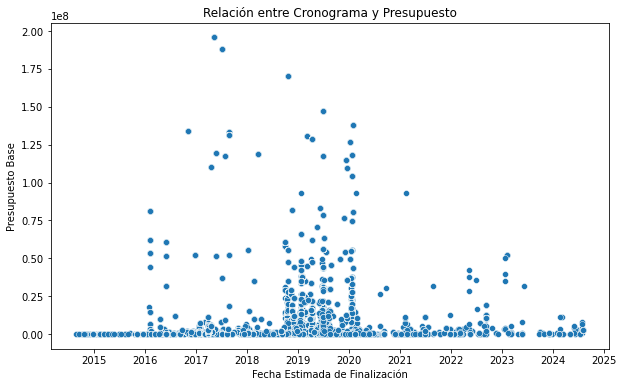

In [216]:
# Gráfico de dispersión para la relación entre cronograma y presupuesto
plt.figure(figsize=(10, 6))
sns.scatterplot(data=dataframe, x='proy_fecha_est_act', y='pre_base')
plt.title('Relación entre Cronograma y Presupuesto')
plt.xlabel('Fecha Estimada de Finalización')
plt.ylabel('Presupuesto Base')
plt.show()


* Concentration of Data: Most of the projects, especially the ones with a smaller budget, are concentrated in the years 2018 to 2020. This would mean that most projects within this budget range were due to be completed at this time.

* Outliers and High Budgets: The outliers are very many, particularly around the years 2018 to 2020. Some projects have such a high budget compared to the rest of them. These seem to be between 0.5 and almost 2.0 million, in scientific notation, or even billion, depending on the units.

* Downward Trend Post-2020: In fact, there seems to be a declining trend in both the number of projects and the magnitude of budgets after 2020. This could suggest either a decline in the project numbers or a shift to low-budget projects after this period.

* Projects Post-2020: Comparatively fewer in number, a set of projects after 2020 through to 2025 seem to have lower budgets than that from earlier years. Many factors include political factors, government changes, external elements, pandemics, and seasonality. It is, therefore, important that this model should involve seasonality.

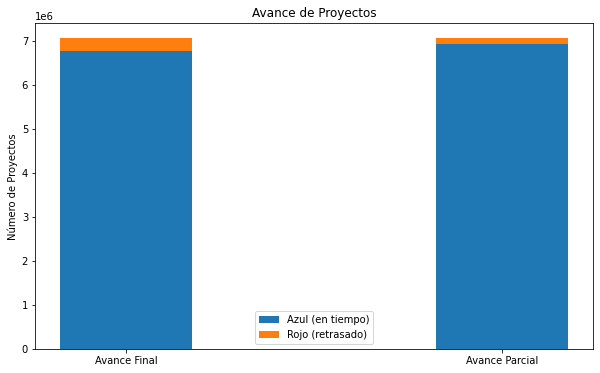

In [223]:
# Gráfico de barras apiladas para el avance de proyectos
avance_fin_azul = dataframe['proyind_avance_fin_azul'].sum()
avance_fin_rojo = dataframe['proyind_anvance_fin_rojo'].sum()
avance_par_azul = dataframe['proyind_avance_par_azul'].sum()
avance_par_rojo = dataframe['proyind_anvance_par_rojo'].sum()

bar_width = 0.35
index = ['Avance Final', 'Avance Parcial']

plt.figure(figsize=(10, 6))
plt.bar(index, [avance_fin_azul, avance_par_azul], bar_width, label='Azul (en tiempo)')
plt.bar(index, [avance_fin_rojo, avance_par_rojo], bar_width, bottom=[avance_fin_azul, avance_par_azul], label='Rojo (retrasado)')
plt.title('Avance de Proyectos')
plt.ylabel('Número de Proyectos')
plt.legend()
plt.show()


In summary, the chart indicates that most projects are completed on time, with only a small fraction experiencing delays, and this trend is consistent whether looking at partial or final project progress.

# Determining variables in projects so far

From the analysis of the matrix and the numbers we can say that the PK of projects has a high correlation with:
* Deliverables 0.99
* Program 0.73
* Schedule 0.99
* Budget 0.99
* Risks 0.95
* Lessons Learned 0.96

See table below

In [234]:

# Supongamos que 'completo' es tu DataFrame real que contiene la matriz de correlación

# Calcular la matriz de correlación
correlation_matrix_1 = data_final.corr()

# Obtener las correlaciones con 'proy_pk'
correlation_with_proy_pk_1 = correlation_matrix_1['proy_pk'].sort_values(ascending=False)

# Convertir en un DataFrame para mejor visualización
df_correlations_1 = correlation_with_proy_pk_1.reset_index()
df_correlations_1.columns = ['Variable', 'Correlación']

# Resaltar valores mayores a 0.5 o menores a -0.5
def highlight_high_correlations(val):
    color = 'blue' if val >= 0.5 or val <= -0.5 else ''
    return f'background-color: {color}'

# Aplicar el formato y mostrar la tabla
df_correlations_1.style.applymap(highlight_high_correlations, subset=['Correlación'])

,Variable,Correlación
0,proy_pk,1.000000
1,proy_pre_fk,0.999274
2,ent_cro_fk,0.997083
3,proy_otr_dat_fk,0.994377
4,proy_proyindices_fk,0.994267
5,proy_cro_fk,0.993657
6,risk_ent_fk,0.986014
7,ent_pk,0.986014
8,con_org_fk,0.978048
9,lecaprcon_con_fk,0.967269


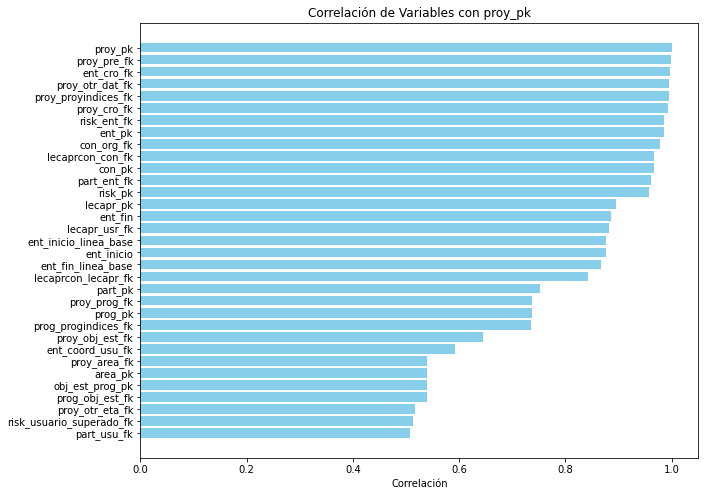

In [235]:
# Datos proporcionados
data = {
    'Variable': [
        'proy_pk', 'proy_pre_fk', 'ent_cro_fk', 'proy_otr_dat_fk', 'proy_proyindices_fk',
        'proy_cro_fk', 'risk_ent_fk', 'ent_pk', 'con_org_fk', 'lecaprcon_con_fk', 'con_pk',
        'part_ent_fk', 'risk_pk', 'lecapr_pk', 'ent_fin', 'lecapr_usr_fk', 
        'ent_inicio_linea_base', 'ent_inicio', 'ent_fin_linea_base', 'lecaprcon_lecapr_fk', 
        'part_pk', 'proy_prog_fk', 'prog_pk', 'prog_progindices_fk', 'proy_obj_est_fk', 
        'ent_coord_usu_fk', 'proy_area_fk', 'area_pk', 'obj_est_prog_pk', 'prog_obj_est_fk', 
        'proy_otr_eta_fk', 'risk_usuario_superado_fk', 'part_usu_fk'
    ],
    'Correlación': [
        1.000000, 0.999274, 0.997083, 0.994377, 0.994267, 0.993657, 0.986014, 0.986014,
        0.978048, 0.967269, 0.967269, 0.960661, 0.956731, 0.894849, 0.885155, 0.882661,
        0.875808, 0.875455, 0.866287, 0.842976, 0.751231, 0.737078, 0.737078, 0.735333,
        0.645375, 0.592592, 0.539791, 0.539791, 0.538519, 0.538519, 0.517759, 0.513870,
        0.508186
    ]
}

# Convertir a DataFrame
df = pd.DataFrame(data)

# Crear el gráfico de barras
plt.figure(figsize=(10, 8))
plt.barh(df['Variable'], df['Correlación'], color='skyblue')
plt.xlabel('Correlación')
plt.title('Correlación de Variables con proy_pk')
plt.gca().invert_yaxis()  # Invertir el eje y para que la variable más correlacionada esté en la parte superior
plt.show()


In [236]:
# Seperamos las variables categoricas de las variables numericas

num_vars = completo.columns[completo.dtypes != 'object']
cat_vars = completo.columns[completo.dtypes == 'object']

print("Numerical variables:", num_vars)
print("Categorical variables:", cat_vars)

Numerical variables: Index(['area_pk', 'cro_proy_ent_seleccionado',
       'cro_proy_permiso_escritura_padre', 'ent_cro_fk', 'ent_descripcion',
       'ent_duracion', 'ent_duracion_linea_base', 'ent_esfuerzo', 'ent_fin',
       'ent_fin_linea_base', 'ent_id', 'ent_inicio', 'ent_inicio_linea_base',
       'ent_nivel', 'ent_nombre', 'ent_parent', 'ent_pk', 'ent_progreso',
       'ent_relevante', 'est_proy_orden_prroceso', 'est_proy_pk',
       'fue_habilitada', 'fue_nombre', 'fue_pk', 'mon_proy_nombre',
       'mon_proy_pk', 'mon_proy_signo', 'mon_proy_version',
       'obj_est_proy_descripcion', 'obj_est_proy_habilitado',
       'obj_est_proy_nombre', 'obj_est_proy_org_fk', 'pre_base',
       'pre_fuente_organi_fk', 'pre_moneda', 'proy_activo', 'proy_area_fk',
       'proy_cro_fk', 'proy_descripcion', 'proy_est_fk', 'proy_factor_impacto',
       'proy_fecha_act', 'proy_fecha_act_pub', 'proy_fecha_crea',
       'proy_fecha_est_act', 'proy_nombre', 'proy_obj_est_fk',
       'proy_obj_publ

In [237]:
completo[num_vars].isnull().sum()

area_pk                                 0
cro_proy_ent_seleccionado             419
cro_proy_permiso_escritura_padre      345
ent_cro_fk                          60135
ent_descripcion                     70707
                                    ...  
proyind_metodo_sin_aprobar              0
proyind_periodo_fin                     0
proyind_riesgo_alto                     0
proyind_riesgo_expo                 66431
proyind_riesgo_ultact               55669
Length: 73, dtype: int64

In [238]:
completo.sample(5)

,area_pk,cro_proy_ent_seleccionado,cro_proy_permiso_escritura_padre,ent_cro_fk,ent_descripcion,ent_duracion,ent_duracion_linea_base,ent_esfuerzo,ent_fin,ent_fin_linea_base,...,proyind_fase_color,proyind_fecha_act,proyind_fecha_act_color,proyind_metodo_estado,proyind_metodo_sin_aprobar,proyind_periodo_fin,proyind_periodo_inicio,proyind_riesgo_alto,proyind_riesgo_expo,proyind_riesgo_ultact
82651,124,1.0,0.0,NaN,<NA>,NaN,NaN,NaN,NaN,NaN,...,0,2019-10-09,4,NaN,0,2019-06-28,2017-08-01 00:00:00,0,NaN,NaT
89567,196,2.0,0.0,NaN,<NA>,NaN,NaN,NaN,NaN,NaN,...,0,2019-10-09,4,0.00,0,2019-02-21,2018-01-09 00:00:00,0,NaN,NaT
732,1,13.0,1.0,NaN,<NA>,NaN,NaN,NaN,NaN,NaN,...,0,2019-10-09,4,78.26,0,2016-11-30,2014-09-03 00:00:00,0,3.87,2016-09-27
30886,122,5.0,1.0,NaN,<NA>,NaN,NaN,NaN,NaN,NaN,...,0,2019-10-09,4,NaN,0,2017-05-02,2015-11-26 00:00:00,0,NaN,NaT
54353,124,0.0,0.0,NaN,<NA>,NaN,NaN,NaN,NaN,NaN,...,0,2019-10-09,4,NaN,0,2019-07-02,2016-10-01 00:00:00,0,NaN,NaT


In [239]:
completo.describe(include='all')

,area_pk,cro_proy_ent_seleccionado,cro_proy_permiso_escritura_padre,ent_cro_fk,ent_descripcion,ent_duracion,ent_duracion_linea_base,ent_esfuerzo,ent_fin,ent_fin_linea_base,...,proyind_fase_color,proyind_fecha_act,proyind_fecha_act_color,proyind_metodo_estado,proyind_metodo_sin_aprobar,proyind_periodo_fin,proyind_periodo_inicio,proyind_riesgo_alto,proyind_riesgo_expo,proyind_riesgo_ultact
count,71383.000000,70964.000000,71038.000000,11248.000000,676,11248.000000,11248.000000,11248.000000,1.124800e+04,1.124800e+04,...,71383.0,71383,71383.000000,19584.000000,71383.000000,71383,71383,71383.000000,4952.000000,15714
unique,NaN,NaN,NaN,NaN,256,NaN,NaN,NaN,NaN,NaN,...,NaN,612,NaN,NaN,NaN,1635,1591,NaN,NaN,757
top,NaN,NaN,NaN,NaN,Se eleva el informe al Directorio y ste adjudi...,NaN,NaN,NaN,NaN,NaN,...,NaN,2019-10-09 00:00:00,NaN,NaN,NaN,2020-01-20 00:00:00,2015-07-01 00:00:00,NaN,NaN,2017-06-12 00:00:00
freq,NaN,NaN,NaN,NaN,60,NaN,NaN,NaN,NaN,NaN,...,NaN,53964,NaN,NaN,NaN,3914,4719,NaN,NaN,2352
first,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,2016-03-14 00:00:00,NaN,NaN,NaN,2009-09-02 00:00:00,NaN,NaN,NaN,2014-08-28 00:00:00
last,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,2024-08-19 00:00:00,NaN,NaN,NaN,2027-11-01 00:00:00,NaN,NaN,NaN,2024-08-08 00:00:00
mean,140.380441,6.983020,0.194896,2666.753734,NaN,169.328592,223.717994,100.809122,1.491247e+12,1.495545e+12,...,0.0,NaN,3.999944,35.036560,0.014331,NaN,NaN,0.027556,2.115162,NaN
std,73.880298,12.555686,0.396123,1957.446591,NaN,200.027155,271.193466,190.000876,6.541706e+10,6.181455e+10,...,0.0,NaN,0.014971,45.369054,0.118853,NaN,NaN,0.341624,1.658220,NaN
min,1.000000,0.000000,0.000000,265.000000,NaN,0.000000,0.000000,0.000000,1.366643e+12,1.366643e+12,...,0.0,NaN,0.000000,0.000000,0.000000,NaN,NaN,0.000000,0.400000,NaN
25%,123.000000,1.000000,0.000000,1481.000000,NaN,31.000000,31.000000,10.000000,1.445612e+12,1.458918e+12,...,0.0,NaN,4.000000,0.000000,0.000000,NaN,NaN,0.000000,1.200000,NaN


From the above analysis we can see that we are interested in going deeper into Deliverables and Budget, so we will group them into a sub-dataset in order to analyze in a more manageable way. Given that we have already gone into more depth on risks, programs, lessons learned and schedule.

# Entregables

In [241]:
entregables=completo.drop(['area_pk', 'cro_proy_ent_seleccionado', 'cro_proy_permiso_escritura_padre',
    'est_proy_codigo', 'est_proy_nombre', 'est_proy_orden_prroceso', 'est_proy_pk',
    'fue_habilitada', 'fue_nombre', 'fue_pk', 'mon_proy_nombre', 'mon_proy_pk',
    'mon_proy_signo', 'mon_proy_version', 'obj_est_proy_descripcion', 
    'obj_est_proy_habilitado', 'obj_est_proy_nombre', 'obj_est_proy_org_fk', 
    'org_nombre', 'pre_base', 'pre_fuente_organi_fk', 'pre_moneda', 'proy_activo', 
    'proy_area_fk', 'proy_cro_fk', 'proy_descripcion', 'proy_est_fk', 
    'proy_factor_impacto', 'proy_fecha_act', 'proy_fecha_act_pub', 
    'proy_fecha_crea', 'proy_fecha_est_act', 'proy_nombre', 'proy_obj_est_fk', 
    'proy_obj_publico', 'proy_objetivo', 'proy_otr_dat_fk', 'proy_otr_est_pub_fk', 
    'proy_otr_eta_fk', 'proy_peso', 'proy_pre_fk', 'proy_proyindices_fk', 
    'proy_publicable', 'proy_semaforo_amarillo', 'proy_semaforo_rojo', 
    'proy_situacion_actual', 'proyind_anvance_fin_rojo', 'proyind_anvance_par_rojo', 
    'proyind_avance_fin_azul', 'proyind_avance_par_azul', 'proyind_fase_color', 
    'proyind_fecha_act', 'proyind_fecha_act_color', 'proyind_metodo_estado', 
    'proyind_metodo_sin_aprobar', 'proyind_periodo_fin', 'proyind_periodo_inicio', 
    'proyind_riesgo_alto', 'proyind_riesgo_expo', 'proyind_riesgo_ultact'
],axis=1)
entregables.shape

                     

(71383, 18)

In [242]:
entregables.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71383 entries, 0 to 183255
Data columns (total 18 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   ent_cro_fk               11248 non-null  float64
 1   ent_descripcion          676 non-null    string 
 2   ent_duracion             11248 non-null  float64
 3   ent_duracion_linea_base  11248 non-null  float64
 4   ent_esfuerzo             11248 non-null  float64
 5   ent_fin                  11248 non-null  float64
 6   ent_fin_linea_base       11248 non-null  float64
 7   ent_id                   11248 non-null  float64
 8   ent_inicio               11248 non-null  float64
 9   ent_inicio_linea_base    11248 non-null  float64
 10  ent_nivel                11248 non-null  float64
 11  ent_nombre               71383 non-null  string 
 12  ent_parent               11248 non-null  float64
 13  ent_pk                   11248 non-null  float64
 14  ent_predecesor_fk    

In [246]:
# Seleccionar las columnas a analizar relacionadas con "entregables"
columns_to_analyze_entregables = [
    'ent_cro_fk', 'ent_descripcion', 'ent_duracion', 'ent_duracion_linea_base',
    'ent_esfuerzo', 'ent_fin', 'ent_fin_linea_base', 'ent_id', 'ent_inicio',
    'ent_inicio_linea_base', 'ent_nivel', 'ent_nombre', 'ent_parent', 'ent_pk',
    'ent_predecesor_fk', 'ent_progreso', 'ent_relevante', 'proy_pk'
]

# Establecer los valores de referencia de registros esperados para cada columna
expected_counts_entregables = {
    'ent_cro_fk': 11248,
    'ent_descripcion': 11248,
    'ent_duracion': 11248,
    'ent_duracion_linea_base': 11248,
    'ent_esfuerzo': 11248,
    'ent_fin': 11248,
    'ent_fin_linea_base': 11248,
    'ent_id': 11248,
    'ent_inicio': 11248,
    'ent_inicio_linea_base': 11248,
    'ent_nivel': 11248,
    'ent_nombre': 71383,
    'ent_parent': 11248,
    'ent_pk': 11248,
    'ent_predecesor_fk': 11248,
    'ent_progreso': 11248,
    'ent_relevante': 11248,
    'proy_pk': 71383
}

# Calcular la diferencia de registros respecto a los valores esperados
difference_entregables = {col: expected_counts_entregables[col] - completo[col].count() for col in columns_to_analyze_entregables}

# Calcular el porcentaje sobre los valores esperados
percentage_entregables = {col: (completo[col].count() / expected_counts_entregables[col]) * 100 for col in columns_to_analyze_entregables}

# Calcular el porcentaje sobre el total de proyectos (71383)
percentage_total_projects_entregables = {col: (completo[col].count() / 71383) * 100 for col in columns_to_analyze_entregables}

# Calcular el porcentaje con respecto a 'ent_pk'
percentage_with_respect_to_ent_pk = {col: (completo[col].count() / completo['ent_pk'].count()) * 100 for col in columns_to_analyze_entregables}

# Crear un DataFrame con el resultado
result_entregables = pd.DataFrame({
    'Column': columns_to_analyze_entregables,
    'Record Count': [completo[col].count() for col in columns_to_analyze_entregables],
    'Difference from Expected': [difference_entregables[col] for col in columns_to_analyze_entregables],
    'Percentage of Total Expected (%)': [percentage_entregables[col] for col in columns_to_analyze_entregables],
    'Percentage of Total Projects (71383) (%)': [percentage_total_projects_entregables[col] for col in columns_to_analyze_entregables],
    'Percentage with respect to ent_pk (%)': [percentage_with_respect_to_ent_pk[col] for col in columns_to_analyze_entregables]
})

# Ajustar el DataFrame para mejor visualización
result_entregables = result_entregables.reset_index(drop=True)
result_entregables.index += 1  # Inicia el índice en 1 en lugar de 0
result_entregables.columns = [
    'Column', 'Record Count', 'Difference from Expected', 
    'Percentage of Total Expected (%)', 'Percentage of Total Projects (71383) (%)',
    'Percentage with respect to ent_pk (%)'
]

# Aplicar estilo para mejorar la visualización
styled_result_entregables = result_entregables.style.format({
    'Record Count': '{:,.0f}',
    'Difference from Expected': '{:,.0f}',
    'Percentage of Total Expected (%)': '{:.2f}%',
    'Percentage of Total Projects (71383) (%)': '{:.2f}%',
    'Percentage with respect to ent_pk (%)': '{:.2f}%'
}).background_gradient(subset=['Difference from Expected'], cmap='coolwarm')\
   .set_properties(**{
       'border': '1px solid black',
       'padding': '5px',
       'text-align': 'center'
   }).set_table_styles([
       {'selector': 'thead th', 'props': [('background-color', '#4CAF50'), ('color', 'white'), ('text-align', 'center')]},
       {'selector': 'tbody td', 'props': [('text-align', 'center')]}
   ]).set_caption("All Columns, Differences, and Percentages for Entregables with respect to ent_pk")

# Mostrar la tabla estilizada en Jupyter Notebook
styled_result_entregables


,Column,Record Count,Difference from Expected,Percentage of Total Expected (%),Percentage of Total Projects (71383) (%),Percentage with respect to ent_pk (%)
1,ent_cro_fk,"11,248",0,100.00%,15.76%,100.00%
2,ent_descripcion,676,"10,572",6.01%,0.95%,6.01%
3,ent_duracion,"11,248",0,100.00%,15.76%,100.00%
4,ent_duracion_linea_base,"11,248",0,100.00%,15.76%,100.00%
5,ent_esfuerzo,"11,248",0,100.00%,15.76%,100.00%
6,ent_fin,"11,248",0,100.00%,15.76%,100.00%
7,ent_fin_linea_base,"11,248",0,100.00%,15.76%,100.00%
8,ent_id,"11,248",0,100.00%,15.76%,100.00%
9,ent_inicio,"11,248",0,100.00%,15.76%,100.00%
10,ent_inicio_linea_base,"11,248",0,100.00%,15.76%,100.00%


15% of the projects have deliverables while the remaining 85% do not.

In [ ]:
profile = pp.ProfileReport(entregables, title = "EDA_entregables")
profile.to_file(output_file="EDA_entregables.html") 

From the analysis we obtained that a cloud of words was generated for deliverable names in order to know what they are.
The variables with high correlation are entr_parent, entr_relevante is similar to the parent and ent_level among them we will graph the parent variable to know the degree of importance of the deliverable.
Then we will see the duration of the deliverables and the effort

In [248]:
entregebales2=entregables[entregables['ent_nombre'].str.contains('Tramite|Registro|Produccion|agenda|Evolucin|Plan|Taller|Herramienta|Simple|Enseanza|ayuda|Instituciones', case=False)]

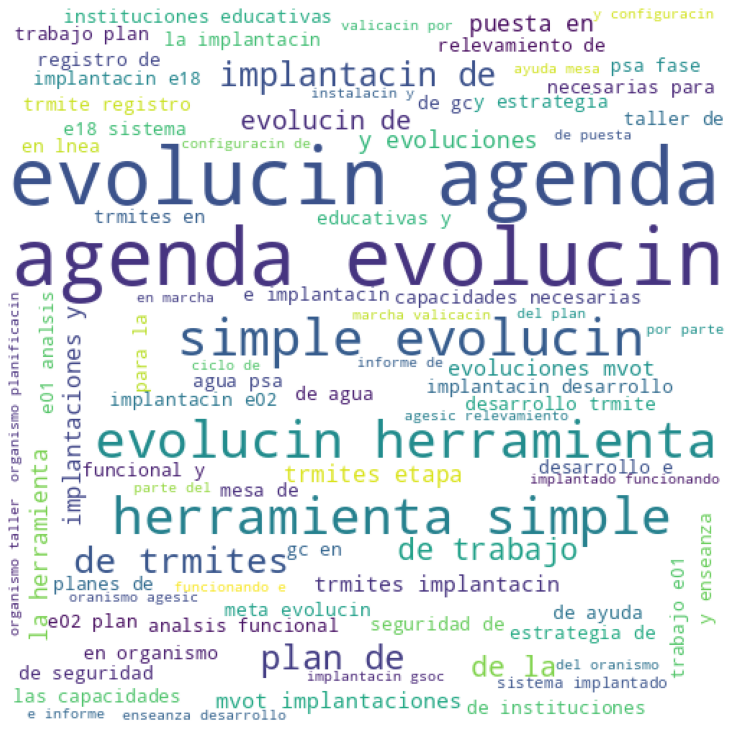

In [249]:
#Nube de palabras para “Group of weather parameters“.
# Python program to generate WordCloud
comment_words = ''
stopwords = set(STOPWORDS)
# iterate through the csv file
for val in entregebales2.ent_nombre:
# typecaste each val to string
    val = str(val)
# split the value
    tokens = val.split()
# Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()   
    comment_words += " ".join(tokens)+" "
wordcloud = WordCloud(width = 500, height = 500,
                    background_color ='white',
                    stopwords = stopwords,
                    min_font_size = 10).generate(comment_words)
# plot the WordCloud image
plt.figure(figsize = (10, 10), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.show()

"evolución" and "agenda": These are the most frequent words, meaning that it suggests the texts are quite centered around them. The focus given to these terms suggests that the dataset might focus on discussions pertaining to development, tracking, or management of agendas or evolution of processes, tools, or systems. "herramienta" (tool) and "simple": These words are also fairly high in the list, showing perhaps that a focus exists on tools which are simple, clear, or easy to use, or ideas on how to make processes simpler. "implantación": This word, too, is consequential, to indicate that the dataset might include the talks related to implementation of a system, tool, or plan.

Related Concepts:

"plan de" (plan of), "implantación de" (implementation of), "herramienta simple" (simple tool): and, by the way, the generated word cloud for such a discussion or document is expected to possibly be related exactly to planning, implementation, and use of tools in a structured or simple manner.
"instituciones educativas" and "capacidades": These would connect the context to a possible relationship with educational institutions or capacity building, therefore further enriching the context related to the content of the dataset.
General Context: A lot of repetition in the terms "development," "security," "strategy," and "analysis" strongly indicates that a dataset is attached to planning, analyzing, and carrying out strategy in some sort of educational, institutional, or technological setting.

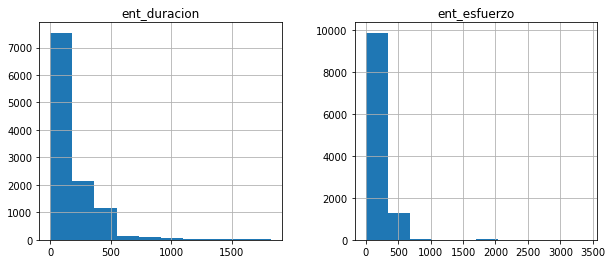

In [250]:
features = ['ent_duracion', 'ent_esfuerzo']
entregables[features].hist(figsize=(10, 4))
plt.show()


Effort and duration are similar if measured in days and range from 0 to 500.

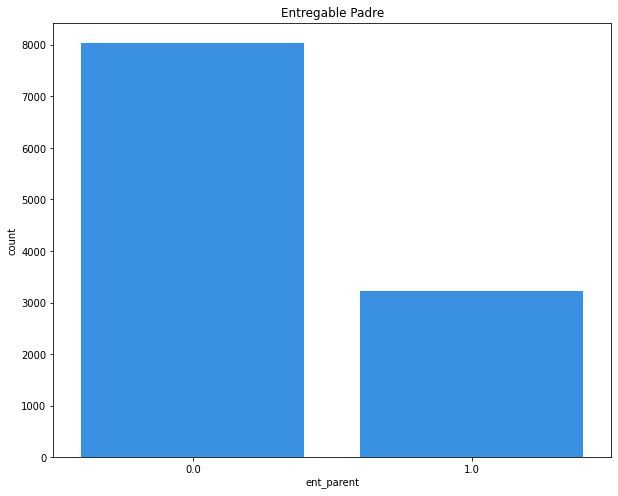

In [251]:
plt.figure(figsize=(10,8))
plt.title('Entregable Padre')
d0 = sns.countplot(data=entregables, x='ent_parent', color='dodgerblue')

In [252]:
entregables['ent_parent'].value_counts() 

0.0    8029
1.0    3219
Name: ent_parent, dtype: int64

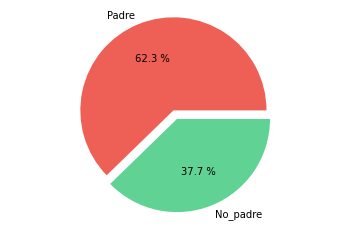

In [253]:
entregables = [4475,2711]
nombres = ["Padre","No_padre"]
colores = ["#EE6055","#60D394"]
desfase = (0, 0.1)
plt.pie(entregables, labels=nombres, autopct="%0.1f %%", colors=colores, explode=desfase)
plt.axis("equal")
plt.show()

62.3% of the deliverables are parent tasks.

# To sum up 
A total of 19 variables with 71,383 records were analyzed. It was found that 15% of the projects have deliverables, while the remaining 85% do not. Of the deliverables, 62.3% are parent tasks.
# Suggest:
1) Ensure that all projects have defined deliverables and/or products.

#  Budget

In [256]:
presupuesto=completo.drop(['cro_proy_ent_seleccionado', 'cro_proy_permiso_escritura_padre', 'ent_cro_fk', 
        'ent_descripcion', 'ent_duracion', 'ent_duracion_linea_base', 'ent_esfuerzo', 
        'ent_fin', 'ent_fin_linea_base', 'ent_id', 'ent_inicio', 'ent_inicio_linea_base', 
        'ent_nivel', 'ent_nombre', 'ent_parent', 'ent_pk', 'ent_predecesor_fk', 
        'ent_progreso', 'ent_relevante', 'est_proy_codigo', 'est_proy_nombre', 
        'est_proy_orden_prroceso', 'est_proy_pk', 'obj_est_proy_descripcion', 
        'obj_est_proy_habilitado', 'obj_est_proy_nombre', 'obj_est_proy_org_fk', 
        'org_nombre', 'proy_activo', 'proy_cro_fk', 'proy_descripcion', 
        'proy_est_fk', 'proy_factor_impacto', 'proy_fecha_act', 'proy_fecha_act_pub', 
        'proy_fecha_crea', 'proy_fecha_est_act', 'proy_nombre', 'proy_obj_est_fk', 
        'proy_obj_publico', 'proy_objetivo', 'proy_otr_dat_fk', 'proy_otr_est_pub_fk', 
        'proy_otr_eta_fk', 'proy_peso', 'proy_proyindices_fk', 'proy_publicable', 
        'proy_semaforo_amarillo', 'proy_semaforo_rojo', 'proy_situacion_actual', 
        'proyind_anvance_fin_rojo', 'proyind_anvance_par_rojo', 'proyind_avance_fin_azul', 
        'proyind_avance_par_azul', 'proyind_fase_color', 'proyind_fecha_act', 
        'proyind_fecha_act_color', 'proyind_metodo_estado', 'proyind_metodo_sin_aprobar', 
        'proyind_periodo_fin', 'proyind_periodo_inicio', 'proyind_riesgo_alto', 
        'proyind_riesgo_expo', 'proyind_riesgo_ultact',],axis=1)
presupuesto.shape
                 

(71383, 14)

In [257]:
presupuesto.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71383 entries, 0 to 183255
Data columns (total 14 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   area_pk               71383 non-null  int64  
 1   fue_habilitada        64263 non-null  float64
 2   fue_nombre            64263 non-null  string 
 3   fue_pk                64263 non-null  float64
 4   mon_proy_nombre       65010 non-null  string 
 5   mon_proy_pk           65010 non-null  float64
 6   mon_proy_signo        65010 non-null  string 
 7   mon_proy_version      65010 non-null  float64
 8   pre_base              65218 non-null  float64
 9   pre_fuente_organi_fk  64263 non-null  float64
 10  pre_moneda            65010 non-null  float64
 11  proy_area_fk          71383 non-null  int64  
 12  proy_pk               71383 non-null  int64  
 13  proy_pre_fk           71348 non-null  float64
dtypes: float64(8), int64(3), string(3)
memory usage: 8.2 MB


In [258]:
presupuesto.sample(5)

,area_pk,fue_habilitada,fue_nombre,fue_pk,mon_proy_nombre,mon_proy_pk,mon_proy_signo,mon_proy_version,pre_base,pre_fuente_organi_fk,pre_moneda,proy_area_fk,proy_pk,proy_pre_fk
725,1,0.0,BID2591,2.0,Dólares,2.0,U$S,0.0,59048.0,2.0,2.0,1,485,485.0
39202,244,1.0,RRGG,18.0,Pesos,1.0,$,0.0,3525798.0,18.0,1.0,244,2000,1854.0
11982,123,1.0,RRGGBID,27.0,Pesos,1.0,$,0.0,118787411.0,27.0,1.0,123,1222,1008.0
13041,123,1.0,RRGGBID,27.0,Pesos,1.0,$,0.0,52118534.0,27.0,1.0,123,1224,1010.0
48684,124,1.0,RRGG,18.0,Pesos,1.0,$,0.0,9583051.0,18.0,1.0,124,2305,2160.0


In [262]:
profile = pp.ProfileReport(presupuesto, title = "EDA_presupuesto")
#profile.to_file(output_file="reporteEDA_presupuesto.html") 

In [260]:
df_indice_recet= presupuesto.reset_index()

<Figure size 1080x864 with 0 Axes>

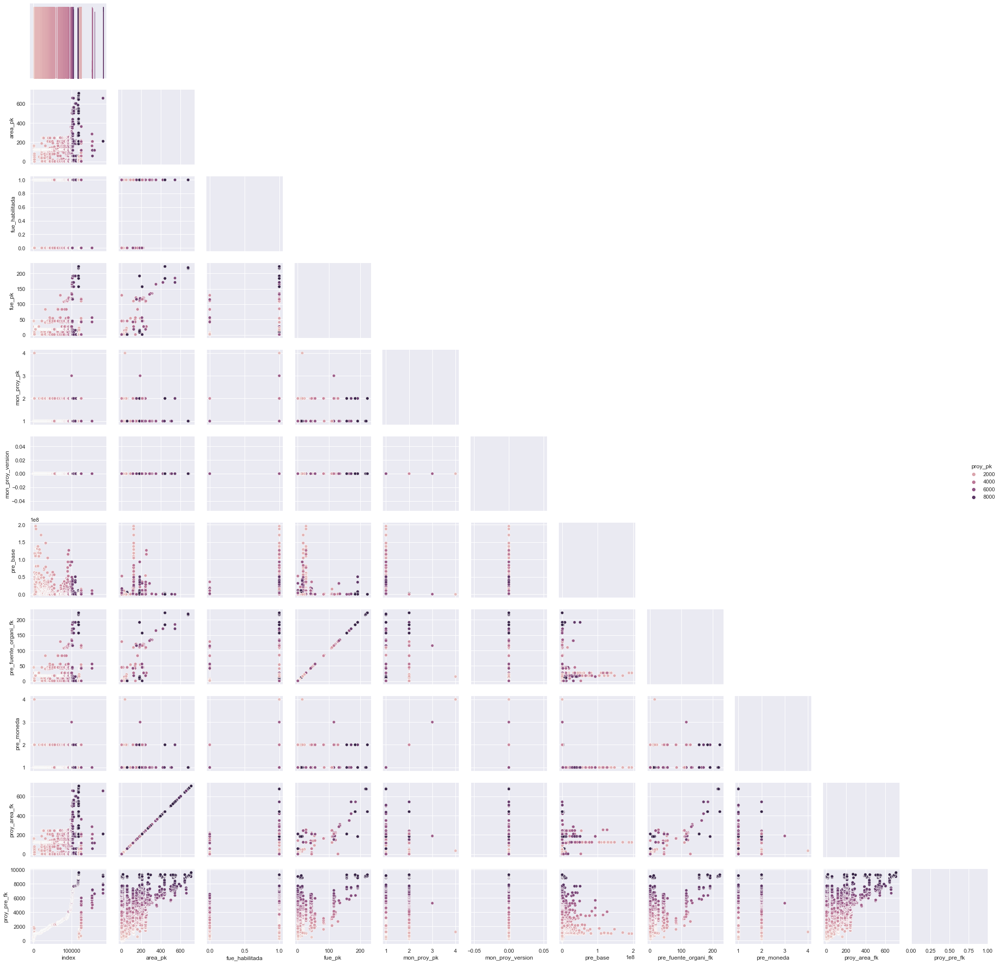

In [261]:
sns.set(style='darkgrid')
plt.figure(figsize=(15,12))
sns.pairplot(df_indice_recet, corner=True, hue='proy_pk')
plt.tight_layout()
plt.show()

In [264]:
ver=presupuesto['pre_base']!= 0
ver

0         False
1         False
2         False
3         False
4         False
          ...  
183251     True
183252     True
183253     True
183254     True
183255     True
Name: pre_base, Length: 71383, dtype: bool

In [265]:
## Se completa pre base con un valor medio
presupuesto['pre_base'].fillna(presupuesto['pre_base'].median(), inplace=True)

In [266]:
presupuesto['pre_base'].sample(5)

122108       85000.0
42012      9627495.0
2473       9627495.0
23541     14614002.0
65369      1496000.0
Name: pre_base, dtype: float64

In [267]:
sns.set_style('darkgrid')
plt.rcParams['font.size'] = 14
plt.rcParams['figure.figsize'] = (20, 9)
plt.rcParams['figure.facecolor'] = '#00000000'
plt.rcParams['lines.linewidth'] = 2
# plt.style.use('fivethirtyeight')

In [268]:
pesos = presupuesto.query("mon_proy_signo == '$'")
dolares = presupuesto.query("mon_proy_signo == 'U$S '")


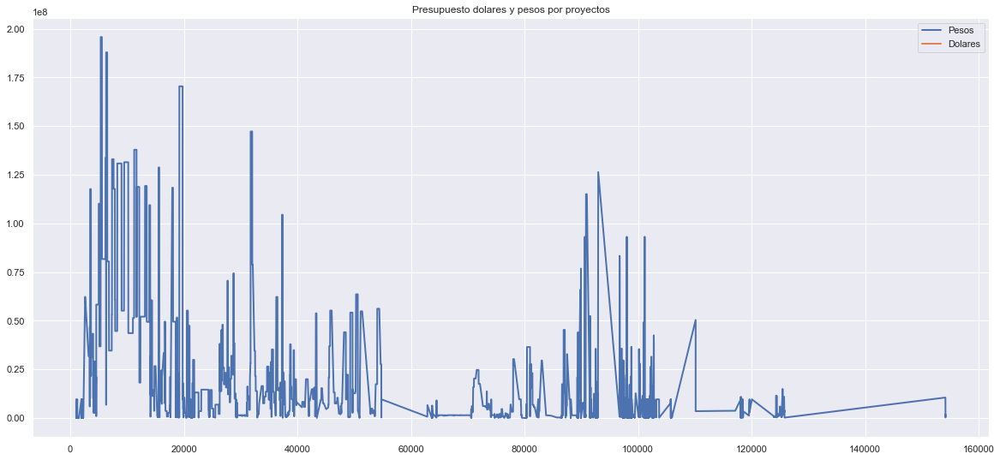

In [269]:
pesos['pre_base'].plot(label = "Pesos")
dolares['pre_base'].plot(label = 'Dolares')

plt.title('Presupuesto dolares y pesos por proyectos')
plt.legend()
plt.show()

Budget Distribution: There is a wide distribution of project budgets, with some projects requiring significantly higher investments than others. High Variability: The high variability in budgets is indicative of the analyzed projects having vastly different scopes, sizes, or requirements of resources. Possible Outliers: These high spikes may represent outliers or particularly large-scaled projects that should be considered when analyzing the overall budget distribution.

The currency used in this case is not the currency of the project payment, but rather the currency of the acquisition, so it is recommended to review this issue. A comprehensive EDA of payments is carried out below.

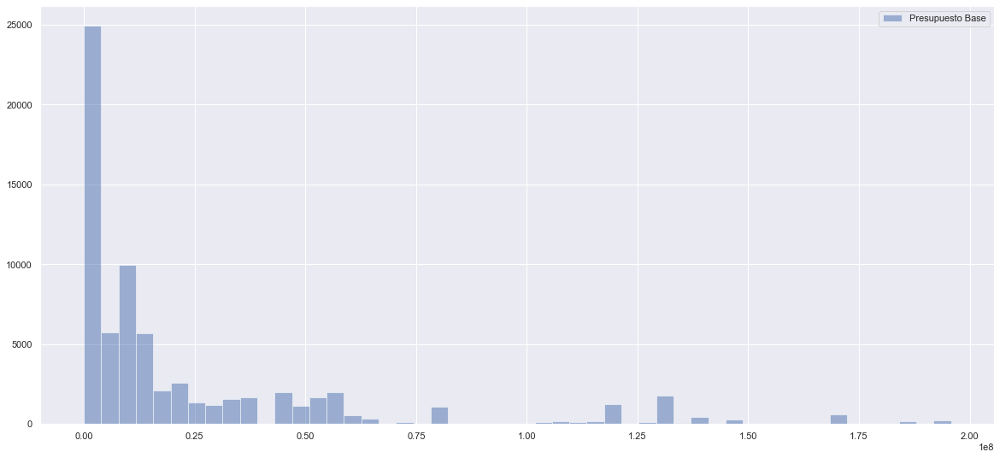

In [270]:
plt.hist(presupuesto['pre_base'], alpha=0.5, label='Presupuesto Base', bins=50, color='b')
plt.legend()
plt.rcParams['figure.figsize'] = (12, 9)

Skewed Distribution: The distribution is highly skewed to the right, with most data densities at the lower end. Such a distribution is very common in financial data, where one or a few large projects would dominate the total budget and many other projects would have relatively small portions of it.

Potential Outliers: The few data points at the higher end may be potential outliers or a reflection of the special cases that really demand so much more in resources.

Analytic Focus: The high concentration of the smaller values in data indicates that most resources are allocated to many small projects, while very few huge projects are allocated a disproportionately high amount of resources.

In [271]:
# Para ver los outliers
fig = px.box(presupuesto, y="pre_base")
fig.show()

Skewed Distribution: The data is positively skewed, with only a few projects having extraordinarily high base budgets compared to most others.

Outliers: The outliers show that there are some projects with much bigger budgets that might require more scrutiny or special management.

Budget Allocation: Many projects run on very modest budgets, and a very few may account for the largest proportion of the budget.

#### General Recomendation

* Improve the risk log to be more exhaustive and detailed, as only 13 risks currently represent the most commonly applied ones.
* The average of 7 to 8 risks per project is perceived as too few risks per project.
* It is recommended to have opportunities individualized in some way.
* It would be good to have a standardized categorization of risks.
* It is recommended to generate responses to risks since 40% are unaddressed.
* Review the documentation of lessons learned as well as the process of generating them.
* Ensure all projects have defined deliverables and/or products.
* The currency used here is not the currency of project payment but that of the acquisition, which is recommended to be reviewed.
* Maintain the risk weighting criteria as their distribution is adequate.
* All projects should have descriptions, objectives, and benefits.
Wekan board titles should be associated with SIGES IDs to maintain traceability.
* All projects must have a current status.
Standardize the criteria for yellow and red traffic lights based on certain variables to analyze the data without bias.
* It is recommended that all projects have associated deliverables/products.
* It is recommended to upload the budget estimate to have a baseline, as only 25% currently have it.
* Review the structure of the tables, for example, the payments section lacks a currency ID, requiring acquisition details to obtain it.
* Improve the quality of data, such as lessons learned.
* For risks, improve the quality as they are often incorporated mandatorily and do not fully reflect the real risks useful for data analysis.
* Improve the budget scale, for example:
"Tipo_Presupuesto" (Budget Type)
"Subejecución" ($ - Possible Under-execution, more than 30% deviation)
"Correcto" ($ - Execution within Planned, less than 15% deviation)
"Sobreejecución" ($ - Possible Over-execution, more than 20% deviation).
This list aims to enhance project management and data quality in the system.